# Index

1. [Importação de Libs](#importação-de-libs) - Obrigatório
2. [Teste de GPU](#teste-de-gpu) - Opcional
3. [Definição de Funções](#definição-de-funções) - Obrigatório
4. [Definição de Variáveis Globais](#Definição-de-Variáveis-Globais) - Obrigatório

# Importação de Libs

Nesta etapa, iremos importar as bibliotecas necessárias para a execução do projeto.

In [1]:
import PIL
import PIL.Image
import os
import random
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
import pandas as pd
import tensorflow as tf
from os import path
from zipfile import ZipFile
from pathlib import Path
from sklearn import tree
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeRegressor
import multiprocessing
from functools import partial
from multiprocessing import Pool
import workers
from keras import Sequential
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization,  AveragePooling2D
from keras.regularizers import l2
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import confusion_matrix, cohen_kappa_score
import matplotlib.ticker as mticker
import datetime
import math

# Teste de GPU

Nesta etapa, testamos a máquina em que esta sendo executado o projeto para verificar se há GPUs para serem utilizadas.

In [2]:
# Verifica a quantidade de GPUs disponíveis
print("GPUs: ", len(tf.config.list_physical_devices('GPU')))

GPUs:  0


# Definição de Funções

Nesta etapa, iremos definir as funções que serão utilizadas ao longo do projeto.

## Função para retornar array de arquivos

In [3]:
def get_files(path):
  files = [entry.name for entry in os.scandir(path) if entry.is_file()]
  files.sort()

  return files

## Função para carregar imagens

In [4]:
def load_images(image_names, path):
  return [PIL.Image.open(os.path.join(path, image)).convert("RGB") for image in image_names]

## Função para retornar nomes de imagens

In [5]:
def get_names(images):
  return [i.split('.png')[0] for i in images]

# Carregamento das imagens

## Imagens pintadas

In [6]:
def get_names(images):
  return [i.split('.png')[0] for i in images]

def load_images(image_names, path):
  return [PIL.Image.open(os.path.join(path, image)).convert("RGB") for image in image_names]


painted_images_path = os.path.abspath('./data/painted_images/') # Renomeie para o seu diretório que contém as imagens rotuladas
imagens_pintadas = get_files(painted_images_path)
nomes_pintadas = get_names(imagens_pintadas)
pintadas = load_images(imagens_pintadas, painted_images_path)

print(imagens_pintadas)
print(nomes_pintadas)
print(pintadas)
print("Quantidade de imagens pintadas:", len(imagens_pintadas))

['basemap1_pintada.png', 'basemap2_pintada.png', 'basemap3_pintada.png', 'basemap4_pintada.png', 'basemap5_pintada.png', 'earth1_pintada.png', 'earth2_pintada.png', 'earth3_pintada.png', 'earth4_pintada.png', 'earth5_pintada.png', 'earth6_pintada.png', 'earth7_pintada.png', 'planet1_pintada.png', 'planet2_pintada.png', 'planet3_pintada.png', 'sentinel10_pintada.png', 'sentinel1_pintada.png', 'sentinel2_pintada.png', 'sentinel3_pintada.png', 'sentinel4_pintada.png', 'sentinel5_pintada.png', 'sentinel6_pintada.png', 'sentinel7_pintada.png', 'sentinel8_pintada.png', 'sentinel9_pintada.png']
['basemap1_pintada', 'basemap2_pintada', 'basemap3_pintada', 'basemap4_pintada', 'basemap5_pintada', 'earth1_pintada', 'earth2_pintada', 'earth3_pintada', 'earth4_pintada', 'earth5_pintada', 'earth6_pintada', 'earth7_pintada', 'planet1_pintada', 'planet2_pintada', 'planet3_pintada', 'sentinel10_pintada', 'sentinel1_pintada', 'sentinel2_pintada', 'sentinel3_pintada', 'sentinel4_pintada', 'sentinel5_pint

## Imagens originais

In [93]:
original_images_path = os.path.abspath('./data/original_images/')  # Renomeie para o seu diretório que contém as imagens originais
imagens_originais = get_files(original_images_path)
nomes_originais = get_names(imagens_originais)
originais = load_images(imagens_originais, original_images_path)

print(imagens_originais)
print(nomes_originais)
print(originais)
print("Quantidade de imagens originais:", len(imagens_originais))

['basemap1_original.png', 'basemap2_original.png', 'basemap3_original.png', 'basemap4_original.png', 'basemap5_original.png', 'earth1_original.png', 'earth2_original.png', 'earth3_original.png', 'earth4_original.png', 'earth5_original.png', 'earth6_original.png', 'earth7_original.png', 'planet1_original.png', 'planet2_original.png', 'planet3_original.png', 'sentinel10_original.png', 'sentinel1_original.png', 'sentinel2_original.png', 'sentinel3_original.png', 'sentinel4_original.png', 'sentinel5_original.png', 'sentinel6_original.png', 'sentinel7_original.png', 'sentinel8_original.png', 'sentinel9_original.png']
['basemap1_original', 'basemap2_original', 'basemap3_original', 'basemap4_original', 'basemap5_original', 'earth1_original', 'earth2_original', 'earth3_original', 'earth4_original', 'earth5_original', 'earth6_original', 'earth7_original', 'planet1_original', 'planet2_original', 'planet3_original', 'sentinel10_original', 'sentinel1_original', 'sentinel2_original', 'sentinel3_ori

In [14]:
nomes_originais[9]

'earth5_original'

# Visualização das imagens

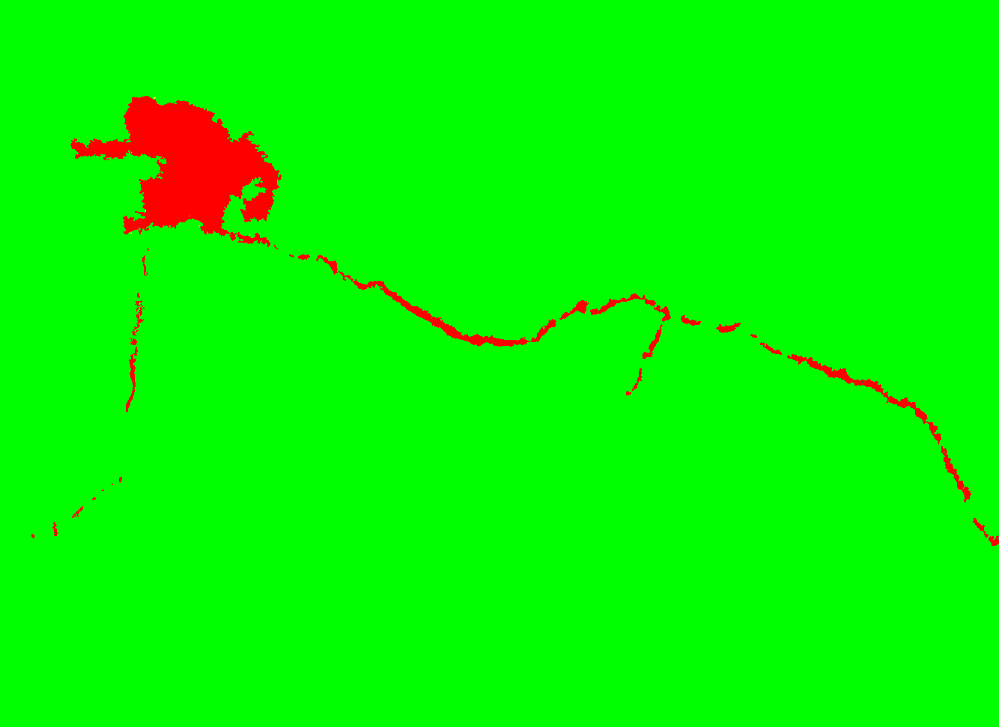

In [20]:
pintadas[9]

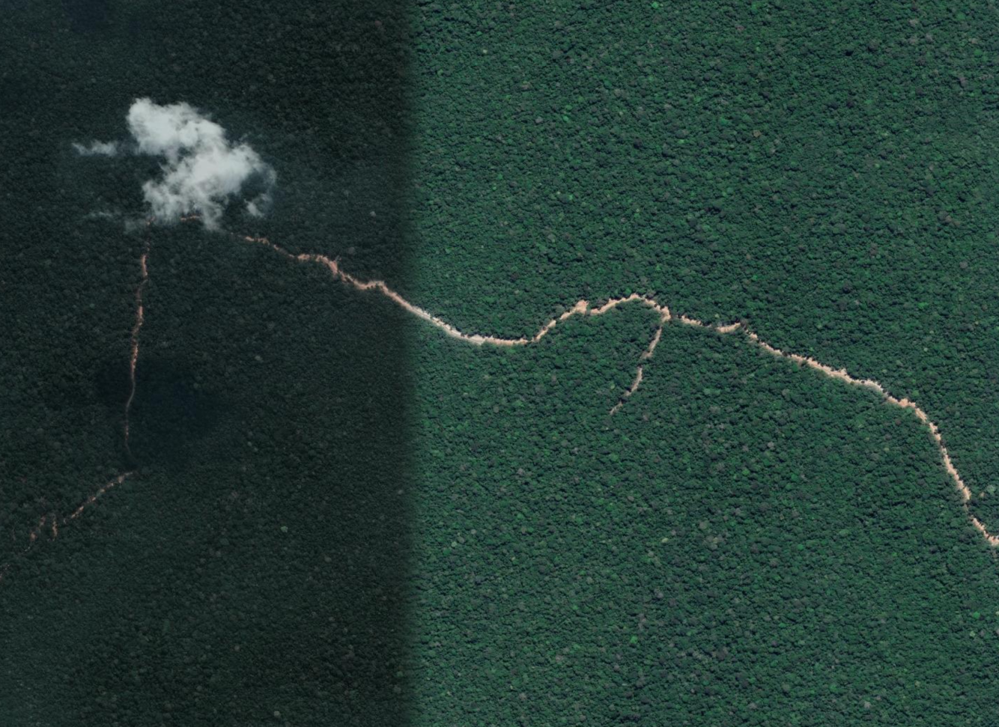

In [21]:
originais[9]

# Geração do conjunto de dados

In [27]:
caminho_pasta = os.path.abspath('./data/dataset/tree')  # Renomeie para o seu diretório que contém as imagens de floresta

# Lista todos os arquivos na pasta
arquivos = get_files(caminho_pasta) # Original: 42.7s

# Conta o número de arquivos na lista
quantidade_arquivos = len(arquivos)

print("Número de arquivos na pasta:", quantidade_arquivos)

Número de arquivos na pasta: 159689


In [28]:
caminho_pasta = os.path.abspath('./data/dataset/not_tree')  # Renomeie para o seu diretório que contém as imagens de demais áreas

# Lista todos os arquivos na pasta
# arquivos = os.listdir(caminho_pasta)
arquivos = get_files(caminho_pasta)

# Conta o número de arquivos na lista
quantidade_arquivos = len(arquivos)

print("Número de arquivos na pasta:", quantidade_arquivos)

Número de arquivos na pasta: 0


In [94]:
pixels_arvore = []
pixels_nao_arvore = []

Função que retorna as coordenadas de uma bounding box

In [95]:
def box(posicao, pixels_janela):
    x, y = posicao
    left = x - pixels_janela // 2
    upper = y - pixels_janela // 2
    right = left + pixels_janela
    lower = upper + pixels_janela
    return (left, upper, right, lower)

Atribui os valores do RGB, onde:
- Árvore: vermelho
- Não árvore: verde

In [96]:
arvore = (0, 255, 0)
nao_arvore = (255, 0, 0)

Adiciona nos arrays a posição baseada na imagem pintada

In [97]:
def pegar_posicao(pintadas, w, h):

  for x in range(w):
      for y in range(h):
          posicao = (x, y)
          cor = pintadas.getpixel(posicao)
          if cor == arvore:
              pixels_arvore.append(posicao)
          elif cor == nao_arvore:
              pixels_nao_arvore.append(posicao)

In [98]:
print(len(pixels_arvore))
print(len(pixels_nao_arvore))
print(len(originais))

0
0
25


Verifica quantos pixels tem em cada imagem do array de images (criado para testes, não é necessário executar)

In [ ]:
def count_pixels(images):
  pixel_counts = []
  for img in images:
      pixel_counts.append(np.prod(img.size))
  return pixel_counts

images = pintadas
pixel_counts = count_pixels(images)

for i, count in enumerate(pixel_counts):
  print(f'Image {i}: {count} pixels')

Image 0: 187109 pixels
Image 1: 116046 pixels
Image 2: 514242 pixels
Image 3: 644988 pixels
Image 4: 517420 pixels
Image 5: 154433 pixels
Image 6: 117300 pixels
Image 7: 97569 pixels
Image 8: 82128 pixels
Image 9: 1295314 pixels
Image 10: 1336702 pixels
Image 11: 1433322 pixels
Image 12: 1068056 pixels
Image 13: 1320660 pixels
Image 14: 1280749 pixels
Image 15: 1084105 pixels
Image 16: 170940 pixels
Image 17: 81016 pixels
Image 18: 82150 pixels
Image 19: 71788 pixels
Image 20: 104310 pixels
Image 21: 50456 pixels
Image 22: 53200 pixels
Image 23: 150470 pixels
Image 24: 70966 pixels


Faz a média da quantidade de pixels em cada imagem (criado para testes, não é necessário executar)

In [47]:
pixel_counts = [187109, 116046, 514242, 644988, 517420, 154433, 117300, 97569, 82128, 1295314, 1336702, 1433322, 1068056, 1320660, 1280749, 1084105, 170940, 81016, 82150, 71788, 104310, 50456, 53200, 150470, 70966]
mean = 0.0

for i in pixel_counts:
  mean += i * 0.03

average = sum(pixel_counts) / len(pixel_counts)
print(f'Média de pixels: {average}')

print(f'Total de pixels: {mean}')

Média de pixels: 483417.56
Total de pixels: 362563.17


## Imagens Não-Árvore

In [36]:
len(pixels_nao_arvore)

0

Pega imagem original, corta ela em pedaços menores (64x64) em posições aleatórias, e salva cada pedaço usando o nome do arquivo. A função cortar_nao_arvore foi modificada para aceitar o número de pixels que deve usar de cada imagem como um argumento. O número de pixels é calculado dividindo o número total de imagens que quero criar pelo número de imagens originais, garantindo que cada imagem original seja usada aproximadamente o mesmo número de vezes. A função min é usada para garantir que ela não tente usar mais pixels do que estão disponíveis em uma imagem.

In [37]:
path = os.path.abspath('./data/dataset_tcc/not_tree/')
total_imagens_nao_arvore = 0
i = 0

def cortar_nao_arvore(original, num, numero_imagens):
  for i in range(numero_imagens):
    global total_imagens_nao_arvore
    if total_imagens_nao_arvore >= 200000: # Se exceder 200000, para
      break
    posicao = random.choice(pixels_nao_arvore)
    bouding_box = box(posicao, 64)
    img = original.crop(bouding_box)
    img.save(path + '\\' + nomes_originais[num] + f"_nao_arvore{i}.png")
    total_imagens_nao_arvore += 1

for i in range(len(originais)):
  pixels_nao_arvore = []

  w, h = pintadas[i].size
  pegar_posicao(pintadas[i], w, h)

  numero_imagens = min(150000 // len(originais), len(pixels_nao_arvore))
  print("numero de imagens: ", numero_imagens)

  cortar_nao_arvore(originais[i], i, numero_imagens)

numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  4336
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  3308
numero de imagens:  6000
numero de imagens:  6000


Função antiga para criar o dataset do primeiro modelo: (não é necessário executar)

In [99]:
# path = os.path.abspath('./data/dataset/not_tree/')

# total_imagens_nao_arvore = 0
# i = 0

# def cortar_nao_arvore(original, num):
#   for i in range(numero_imagens):
#     posicao = random.choice(pixels_nao_arvore)
#     bouding_box = box(posicao, 64)
#     img = original.crop(bouding_box)
#     img.save(path + '\\' + nomes_originais[num] + f"_arvore{i}.png")

# for i in range(len(originais)):
#   pixels_arvore = []
#   pixels_nao_arvore = []

#   w, h = pintadas[i].size
#   pegar_posicao(pintadas[i], w, h)

#   numero_imagens = (len(pixels_nao_arvore))*0.0375 # pega 0,025%
#   print("pixels: ", len(pixels_nao_arvore))
#   numero_imagens = int(round(numero_imagens, 0)) # converte para int e arredonda
#   print("numero: ", numero_imagens)
#   total_imagens_nao_arvore += numero_imagens

#   cortar_nao_arvore(originais[i], i)

pixels:  79290
numero:  2973
pixels:  67032
numero:  2514
pixels:  419939
numero:  15748
pixels:  554789
numero:  20805
pixels:  472178
numero:  17707
pixels:  73564
numero:  2759
pixels:  73369
numero:  2751
pixels:  35933
numero:  1347
pixels:  4336
numero:  163
pixels:  35077
numero:  1315
pixels:  81292
numero:  3048
pixels:  44854
numero:  1682
pixels:  243938
numero:  9148
pixels:  68385
numero:  2564
pixels:  846776
numero:  31754
pixels:  906593
numero:  33997
pixels:  87654
numero:  3287
pixels:  61602
numero:  2310
pixels:  67267
numero:  2523
pixels:  56828
numero:  2131
pixels:  40823
numero:  1531
pixels:  28981
numero:  1087
pixels:  3308
numero:  124
pixels:  50042
numero:  1877
pixels:  32607
numero:  1223


In [158]:
path + '\\'

'c:\\Workspaces\\vivi-tcc\\src\\data\\dataset_tree\\not_tree\\'

In [38]:
total_imagens_nao_arvore

145644

## Imagens Árvore

Função antiga para criar o dataset do primeiro modelo: (não é necessário executar)

In [40]:
# path = os.path.abspath('./data/dataset_tree/tree/')
# total_imagens_arvore = 0
# i = 0

# for i in range(len(originais)):
#   pixels_arvore = []
#   pixels_nao_arvore = []

#   w, h = pintadas[i].size
#   pegar_posicao(pintadas[i], w, h)

#   numero_imagens = (len(pixels_arvore))*0.928 # pega 928%
#   print("pixels: ", len(pixels_arvore))
#   numero_imagens = int(round(numero_imagens, 0)) # converte para int e arredonda
#   print("numero: ", numero_imagens)
#   total_imagens_arvore += numero_imagens

#   cortar_arvore(originais[i], i)

In [41]:
path = os.path.abspath('./data/dataset_tcc/tree/')
total_imagens_arvore = 0
i = 0

def cortar_arvore(original, num, numero_imagens):
  for i in range(numero_imagens):
    global total_imagens_arvore
    if total_imagens_arvore >= 200000: # Se exceder 200000, para
      break
    posicao = random.choice(pixels_arvore)
    bouding_box = box(posicao, 64)
    img = original.crop(bouding_box)
    img.save(path + '\\' + nomes_originais[num] + f"_arvore{i}.png")
    total_imagens_arvore += 1

for i in range(len(originais)):
  pixels_arvore = []

  w, h = pintadas[i].size
  pegar_posicao(pintadas[i], w, h)

  numero_imagens = min(150000 // len(originais), len(pixels_arvore))
  print("numero de imagens: ", numero_imagens)

  cortar_nao_arvore(originais[i], i, numero_imagens)

numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000
numero de imagens:  6000


In [48]:
total_imagens_arvore

150000

In [43]:
total = total_imagens_arvore + total_imagens_nao_arvore
total

295644

Calcula a diferença relativa para verificar se o número de exemplos para cada classe estão aproximados, evitando o desbalanceamento

In [44]:
num_arvore = total_imagens_arvore
num_nao_arvore = total_imagens_nao_arvore
diferenca_relativa = abs(num_arvore - num_nao_arvore) / max(num_arvore, num_nao_arvore)
diferenca_relativa

0.02904

Se a diferença relativa for pequena, por exemplo, abaixo de 0.1 ou 0.2, podemos considerar que o conjunto de dados está razoavelmente balanceado. Se a diferença relativa for maior, podemos dizer que o conjunto de dados está desbalanceado.

# Construindo o dataset

In [7]:
X = []
y = []

## Arquivos Não Árvore

Carrega as imagens e atribui a classe 0 (demais áreas) aos arrays, para compor o dataset, utilizando paralelismo.

In [8]:
with multiprocessing.Pool(6) as pool:
  path = os.path.abspath('./data/dataset/not_tree/')
  arquivos_nao_arvore = get_files(path)
  print("Quantidade de arquivos não arvore:", len(arquivos_nao_arvore))

  X.extend(pool.map(partial(workers.load_images_as_np_array, path), arquivos_nao_arvore))
  y.extend([0] * len(arquivos_nao_arvore))

print(len(X))
print(len(y))

del arquivos_nao_arvore

Quantidade de arquivos não arvore: 166368
166368
166368


## Arquivos Árvore

Carrega as imagens e atribui a classe 1 (vegetação florestal) aos arrays, para compor o dataset, utilizando paralelismo.

In [9]:
with multiprocessing.Pool(6) as pool:
  path = os.path.abspath('./data/dataset/tree/')
  arquivos_arvore = get_files(path)
  print("Quantidade de arquivos arvore:", len(arquivos_arvore))

  X.extend(pool.map(partial(workers.load_images_as_np_array, path), arquivos_arvore))
  y.extend([1] * len(arquivos_arvore))

print(len(X))
print(len(y))

del arquivos_arvore

Quantidade de arquivos arvore: 159689
326057
326057


# Pré-processamento das imagens

Divide os exemplos do dataset em 80% para treino e 20% para validação

In [10]:
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size = 0.8)

del X
del y

In [11]:
print(len(X_train))
print(len(X_test))
print(len(y_train))
print(len(y_test))

260845
65212
260845
65212


Converte em array numpy

In [12]:
X_train = np.array(X_train)
y_train = np.array(y_train)
X_test = np.array(X_test)
y_test = np.array(y_test)

In [13]:
type(X_train)

numpy.ndarray

In [14]:
print(X_test[0].shape)
print(y_test[0])

(64, 64, 3)
0


In [15]:
# rgb: 3 canais
prev_train = X_train.reshape(X_train.shape[0], 64, 64, 3) # quantidade, altura, largura, canais
prev_test = X_test.reshape(X_test.shape[0], 64, 64, 3)

del X_train
del X_test

Converte de int8 para float32


In [16]:
prev_train = prev_train.astype('float32')
prev_test = prev_test.astype('float32')

In [17]:
prev_test[0]

array([[[44., 63., 69.],
        [44., 63., 69.],
        [45., 64., 70.],
        ...,
        [50., 68., 72.],
        [50., 68., 72.],
        [51., 69., 73.]],

       [[45., 64., 70.],
        [45., 64., 70.],
        [45., 64., 70.],
        ...,
        [50., 68., 72.],
        [50., 68., 72.],
        [51., 69., 73.]],

       [[46., 65., 71.],
        [46., 65., 71.],
        [46., 65., 71.],
        ...,
        [50., 68., 72.],
        [51., 69., 73.],
        [51., 69., 73.]],

       ...,

       [[51., 69., 73.],
        [52., 70., 74.],
        [52., 70., 74.],
        ...,
        [53., 71., 71.],
        [53., 71., 71.],
        [53., 71., 71.]],

       [[52., 70., 74.],
        [53., 71., 75.],
        [53., 71., 75.],
        ...,
        [53., 71., 71.],
        [53., 71., 71.],
        [53., 71., 71.]],

       [[53., 71., 75.],
        [54., 72., 76.],
        [54., 72., 76.],
        ...,
        [54., 72., 72.],
        [53., 71., 71.],
        [53., 71., 71.]]

In [18]:
type(y_test[0])

numpy.int32

Normaliza os dados, convertendo na escala de 0 a 1

In [19]:
prev_train /= 255
prev_test /= 255

In [20]:
prev_test[0]

array([[[0.17254902, 0.24705882, 0.27058825],
        [0.17254902, 0.24705882, 0.27058825],
        [0.1764706 , 0.2509804 , 0.27450982],
        ...,
        [0.19607843, 0.26666668, 0.28235295],
        [0.19607843, 0.26666668, 0.28235295],
        [0.2       , 0.27058825, 0.28627452]],

       [[0.1764706 , 0.2509804 , 0.27450982],
        [0.1764706 , 0.2509804 , 0.27450982],
        [0.1764706 , 0.2509804 , 0.27450982],
        ...,
        [0.19607843, 0.26666668, 0.28235295],
        [0.19607843, 0.26666668, 0.28235295],
        [0.2       , 0.27058825, 0.28627452]],

       [[0.18039216, 0.25490198, 0.2784314 ],
        [0.18039216, 0.25490198, 0.2784314 ],
        [0.18039216, 0.25490198, 0.2784314 ],
        ...,
        [0.19607843, 0.26666668, 0.28235295],
        [0.2       , 0.27058825, 0.28627452],
        [0.2       , 0.27058825, 0.28627452]],

       ...,

       [[0.2       , 0.27058825, 0.28627452],
        [0.20392157, 0.27450982, 0.2901961 ],
        [0.20392157, 0

In [21]:
for i in y_train:
    print(i)

0
0
1
0
1
0
1
1
0
0
0
1
0
1
0
0
0
1
0
0
1
1
1
1
1
0
1
1
1
1
1
0
0
1
1
1
0
1
1
1
1
0
1
0
1
0
0
0
0
1
1
0
0
0
0
0
0
1
0
1
1
1
0
1
0
1
0
0
0
1
0
1
0
1
1
0
1
1
1
0
0
1
0
0
0
0
1
0
0
0
1
1
0
0
1
0
0
1
1
1
0
1
0
0
0
1
0
1
1
1
1
1
0
0
1
1
1
0
1
1
0
0
0
0
0
0
1
1
1
0
1
1
1
0
0
1
1
0
1
1
1
0
0
0
0
0
0
1
0
0
0
1
1
0
0
0
1
1
1
0
1
0
0
0
1
1
0
1
1
1
1
1
0
0
0
0
1
1
0
0
1
0
0
1
1
1
0
0
0
1
1
0
1
0
0
1
0
0
1
0
1
1
0
1
1
1
0
1
1
0
1
1
1
1
1
1
1
1
0
1
1
1
0
0
0
0
1
0
1
1
0
1
1
0
0
1
0
0
0
1
1
0
1
0
0
0
0
0
0
1
0
0
0
1
1
0
1
0
0
1
0
0
0
1
0
0
0
1
0
0
0
0
0
1
1
0
0
0
1
0
0
0
0
0
0
1
0
1
1
1
1
1
1
1
0
1
1
1
0
1
0
1
1
0
0
0
0
1
1
1
1
0
0
0
1
0
0
1
0
0
1
0
0
0
1
0
0
1
1
0
0
1
0
0
1
0
0
1
0
0
0
1
1
0
0
1
1
0
0
0
0
0
0
0
1
1
1
0
1
1
0
1
1
0
0
1
1
0
1
1
0
0
0
1
0
0
1
1
1
1
1
1
0
0
1
1
1
0
0
0
1
0
1
1
1
0
0
1
1
0
1
0
0
0
0
1
1
1
1
1
1
0
1
1
0
0
1
1
1
0
0
1
0
0
0
1
0
0
1
0
0
0
0
0
0
1
1
0
1
0
0
0
0
1
1
0
0
1
1
1
1
0
0
1
1
1
1
1
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
1
0
0
1
0
0
1
0
0
0
0
1
0
1
1
1
0
0
1
0
1
1


Os valores das classes estão em uma só coluna. Transforma em categorias, criando 2 colunas/classes

In [22]:
from keras.utils import to_categorical

class_train = to_categorical(y_train, 2)
class_train

array([[1., 0.],
       [1., 0.],
       [0., 1.],
       ...,
       [1., 0.],
       [1., 0.],
       [0., 1.]])

In [23]:
y_train

array([0, 0, 1, ..., 0, 0, 1])

# Etapa 1 - Convolução

Na convolução, adiciona-se cada elemento da imagem para seus vizinhos, ponderado por um kernel.
Nessa etapa, a imagem, que é representada por uma matriz, é multiplicada por um kernel, resultando em uma outra matriz que expressa o quanto o formato de uma matriz é modificado pela outra.
Matematicamente falando, a convolução é definida como a integral do produto de duas funções "f" e "g" depois que uma é invertida e deslocada. A integral é avaliada para todos os valores de deslocamento, produzindo a função de convolução.

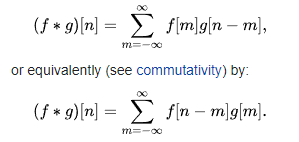

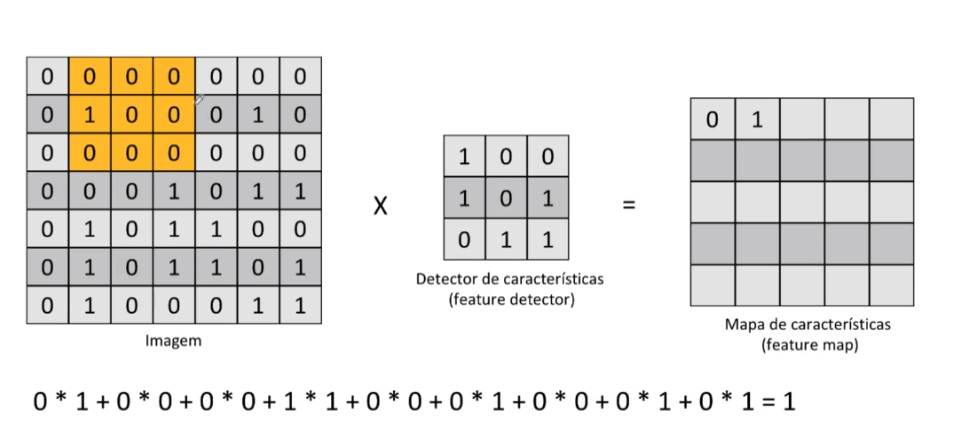

Na etapa de convolução, a imagem será multiplicada por vários kernels, cujos pesos são modificados, gerando novos mapas de características. A rede vai testando todos para escolher qual o melhor kernel/detector de características, e no final, a convolução é formada por esse conjunto de mapa de características. Isso faz com a dimensionalidade seja reduzida.

O número de kernels pode começar com 64 e depois testar com os múltiplos de dois: 128, 256, etc.

# Etapa 2 - Pooling
No Pooling, as imagens são redimensionadas e rotacionadas para enfatizar ainda mais as características dos objetos que serão classificados. Assim, a rede conseguiria detectar o objeto independentemente do fundo no qual o objeto a ser classificado se encontra.

O pooling seleciona as características mais importantes, reduzindo o overfitting e ruídos desnecessários.
O Max-pooling realça as características mais importantes, selecionando os maiores números da janela. Gera o pooled feature map (mapa de característica depois do pooling).

# Etapa 3 - Flattening
Transforma a matriz pooled feature map em vetor, para ser a entrada da rede neural densa.

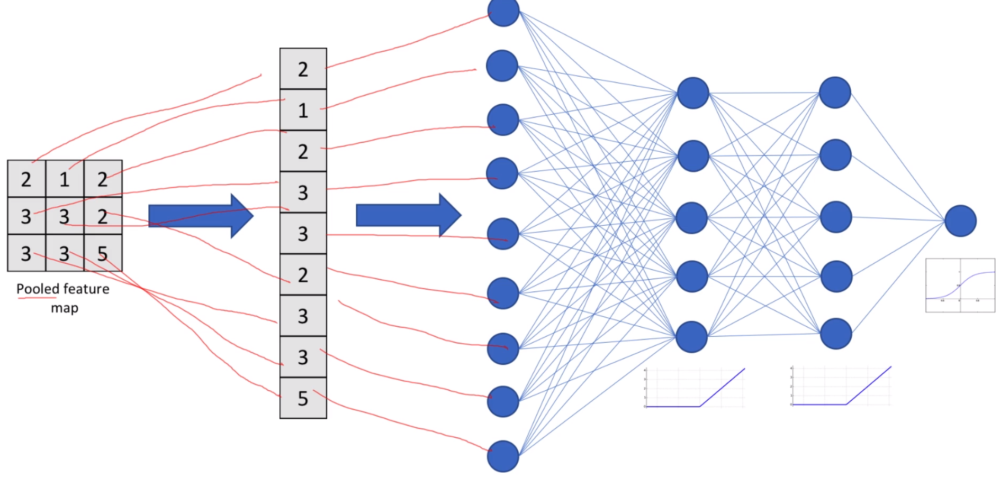

# Etapa 4 - Rede neural densa
Os pesos são atribuídos para cada neurônio, até chegar nos últimos neurônios. Os dois neurônios mais acima serão classificados como 1, os dois mais debaixo serão classificados como 3 e o do meio será classificado como 3.

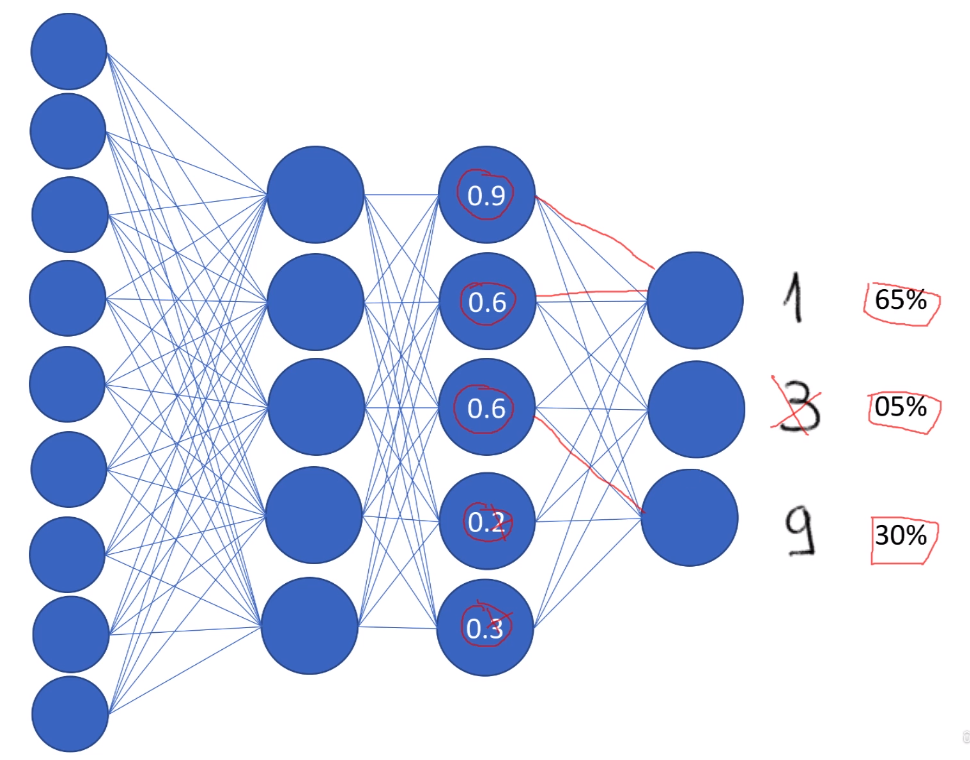

# Todas as etapas da rede neural convolucional

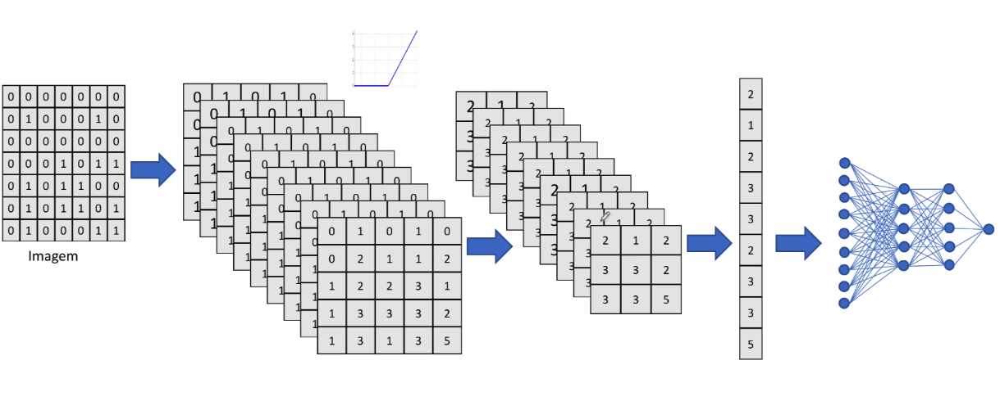

## Primeiro modelo

In [ ]:
classifier = Sequential()

# Operador de convolução
classifier.add(Conv2D(32, (3,3), input_shape=(64,64,3), activation='relu')) # quantidade de detectores de características, tamanho dele, tamanho da imagem, função de ativação -> 64/9=7 -> 57

classifier.add(BatchNormalization())

# Pooling
classifier.add(MaxPooling2D(pool_size = (3,3))) # dimensão da janela do pooling -> 57/3=19 -> 57-19=38

# Flattening
classifier.add(Flatten()) # transforma em vetor

# Rede neural densa
classifier.add(Dense(units = 64, activation = 'relu')) # quantidade de neurônios da camada escondida, função de ativação, dimensão do mapa de características
classifier.add(Dropout(0.5))
classifier.add(Dense(units = 2, activation = 'sigmoid')) # quantidade de saídas
classifier.compile(loss = 'binary_crossentropy', optimizer = 'adam', metrics = ['accuracy'])

history1 = classifier.fit(prev_train, class_train, batch_size = 32, epochs = 10, validation_data = (prev_test, class_test))

c:\Workspaces\vivi-tcc\.venv\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:99: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(


Epoch 1/10
8152/8152 ━━━━━━━━━━━━━━━━━━━━ 513s 62ms/step - accuracy: 0.9247 - loss: 0.2082 - val_accuracy: 0.7540 - val_loss: 0.3758
Epoch 2/10
8152/8152 ━━━━━━━━━━━━━━━━━━━━ 424s 52ms/step - accuracy: 0.9489 - loss: 0.1365 - val_accuracy: 0.9605 - val_loss: 0.1122
Epoch 3/10
8152/8152 ━━━━━━━━━━━━━━━━━━━━ 409s 50ms/step - accuracy: 0.9531 - loss: 0.1231 - val_accuracy: 0.9579 - val_loss: 0.1115
Epoch 4/10
8152/8152 ━━━━━━━━━━━━━━━━━━━━ 405s 50ms/step - accuracy: 0.9549 - loss: 0.1179 - val_accuracy: 0.8584 - val_loss: 0.3502
Epoch 5/10
8152/8152 ━━━━━━━━━━━━━━━━━━━━ 419s 51ms/step - accuracy: 0.9576 - loss: 0.1109 - val_accuracy: 0.9664 - val_loss: 0.0929
Epoch 6/10
8152/8152 ━━━━━━━━━━━━━━━━━━━━ 396s 49ms/step - accuracy: 0.9598 - loss: 0.1062 - val_accuracy: 0.9543 - val_loss: 0.1333
Epoch 7/10
8152/8152 ━━━━━━━━━━━━━━━━━━━━ 404s 49ms/step - accuracy: 0.9610 - loss: 0.1033 - val_accuracy: 0.9651 - val_loss: 0.0874
Epoch 8/10
8152/8152 ━━━━━━━━━━━━━━━━━━━━ 400s 49ms/step - accuracy: 

In [119]:
classifier.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_2 (Conv2D)               │ (None, 62, 62, 32)     │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 62, 62, 32)     │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 20, 20, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 12800)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 64)             │       819,264 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 2)              │           130 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,461,128 (9.39 MB)

 Trainable params: 820,354 (3.13 MB)

 Non-trainable params: 64 (256.00 B)

 Optimizer params: 1,640,710 (6.26 MB)

In [120]:
_, train_acc = classifier.evaluate(prev_train, class_train, verbose=0)
_, test_acc = classifier.evaluate(prev_test, class_test, verbose=0)
print('Train: %.4f, Test: %.4f' % (train_acc, test_acc))

Train: 0.9698, Test: 0.9642


In [121]:
history1.history['accuracy']

[0.9365715384483337,
 0.952811062335968,
 0.9570510983467102,
 0.958124577999115,
 0.9603557586669922,
 0.9610803127288818,
 0.9625217914581299,
 0.9634649157524109,
 0.9640591144561768,
 0.9647836685180664]

Plota a acurácia de treino e validação do primeiro modelo

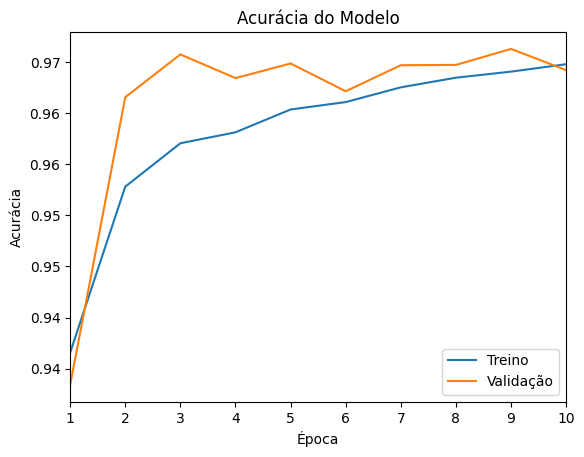

In [122]:
labels = ['1', '2', '3', '4', '5', '6', '7', '8', '9', '10']

plt.plot(history1.history['accuracy'], label='Treino')
plt.plot(history1.history['val_accuracy'], label='Validação')

plt.title('Acurácia do Modelo')
plt.xlabel('Época')
plt.ylabel('Acurácia')

plt.legend(loc='lower right')
# plt.ylim(0.8, 1)
plt.xlim(0, 9)

formatter = mticker.FuncFormatter(lambda x, pos: "{:.2f}".format(x))
plt.gca().yaxis.set_major_formatter(formatter)
plt.xticks(range(0, 10), labels)


plt.show()

Salva o modelo como .keras

In [123]:
path = os.path.abspath('./data/dataset/classifier1.keras')

classifier.save(path)

### Avaliação pelo coeficiente de Kappa e Matriz de confusão

Como o class_test é um vetor one-hot encoded, precisa converter para vetor de rótulos de classe para poder avaliar com kappa e matriz de confusão

In [124]:
# Converte class_test de one-hot encoded para rótulos de classe
class_test = np.argmax(class_test, axis=1)

# Faz previsões nos dados de teste
class_pred = reconstructed_model.predict(prev_test, batch_size=32)

# Converte as previsões para rótulos de classe
class_pred = np.argmax(class_pred, axis=1)

# Calcula a matriz de confusão
conf_mat = confusion_matrix(class_test, class_pred)

print("Matriz de Confusão:")
print(conf_mat)

# Calcula o coeficiente de Kappa
kappa = cohen_kappa_score(class_test, class_pred)

print("\nCoeficiente de Kappa: ", kappa)

2038/2038 ━━━━━━━━━━━━━━━━━━━━ 14s 7ms/step
Matriz de Confusão:
[[31592  1641]
 [  319 31660]]

Coeficiente de Kappa:  0.9399129925996529


### Segmentação das Imagens

Reconstrói o primeiro modelo para usá-lo como um classificador que classifica e pinta cada um dos pixels da imagem, como se fosse um kernel

In [125]:
reconstructed_model = tf.keras.models.load_model(path)

In [9]:
# Retorna as coordenadas de uma bounding box ao redor da posição com o tamanho especificado
def box(position, size):
    
    x, y = position
    left = x - size // 2
    upper = y - size // 2
    right = left + size
    lower = upper + size
    return (left, upper, right, lower)

# Para cada pixel da imagem, cria uma bounding box ao redor desse pixel e recorta a imagem
def subimages(image, box_size):
    
    width, height = image.size
    for x in range(width):
        for y in range(height):
            position = x, y
            bouding_box = box(position, box_size)
            yield image.crop(bouding_box)

# Para cada pixel da imagem, define a cor desse pixel para a próxima cor na sequência
def colorize(image, colors):
    
    width, height = image.size
    i = iter(colors)
    for x in range(width):
        for y in range(height):
            position = x, y
            try:
                color = next(i)
            except:
                return
            image.putpixel(position, color)

# Recebe uma lista de previsões e retorna uma lista de classes, mapeando a função prediction2class para cada previsão na lista

def prediction2class(prediction):
    return sorted(enumerate([i for i in prediction]), key=lambda x: x[1])[-1][0]

def predictions2classes(predictions):
    return list(map(prediction2class, predictions))


class Analyser:
    
    def __init__(self, neural_net, classes_colors, box_size):
        # Inicializa a classe com a rede neural, as cores das classes e o tamanho da bounding box 
        self.neural_net = neural_net
        self.classes_colors = classes_colors
        self.box_size = box_size
        self.image = None

    def analyse(self, image, batch_size = -1):
        # Imprime a data e hora atual
        print(f"{datetime.datetime.now()}")

        # Abre a imagem e converte para RGB
        if isinstance(image, str):
            image = Image.open(image).convert('RGB')
        self.image = image

        # Obtém a largura e a altura da imagem
        width, height = image.size
        counter = width*height

        # Cria uma nova imagem com o mesmo tamanho da imagem original
        self.classified_image = Image.new("RGB", image.size)

        # Se o tamanho do lote for menor que 0, define o tamanho do lote como o contador
        if batch_size < 0:
            batch_size = counter

        # Cria subimagens da imagem original
        iter_images = subimages(image, self.box_size)

        # Inicializa as listas e classes de previsões
        self.predictions = []
        self.predictions_classes = []

        # Inicializa o contador de lotes e o número máximo de lotes
        batch_counter = 1
        max_batches = math.ceil(counter / batch_size)

        try:
            
            while counter > 0:
                
                print(f"{datetime.datetime.now()} - Rodando o lote {batch_counter}/{max_batches}")
                batch_counter += 1
                
                print(f"{datetime.datetime.now()} - Cortando")
                images = [np.array(next(iter_images), dtype=np.float32)/255 for i in range(min(batch_size, counter))]
                X = np.array(images)

                print(f"{datetime.datetime.now()} - Corte Completo")

                print(f"{datetime.datetime.now()} - Prevendo as classes")
                predictions = self.neural_net.predict(X)

                print(f"{datetime.datetime.now()} - Previsao completa")

                # Adiciona as classes previstas à lista
                self.predictions_classes.extend(predictions2classes(predictions))
               
                print(f"{datetime.datetime.now()} - Completo")

                # Diminui o contador pelo tamanho do lote
                counter -= batch_size

        #Imprime a data e hora atual e a exceção
        except Exception as e:
            print(f"{datetime.datetime.now()} - Erro {e}")

        print(f"{datetime.datetime.now()} - Colorindo a imagem final")

        # Mapeia as cores das classes para as classes previstas e pinta a imagem
        colors = map(self.classes_colors.get, self.predictions_classes)
        colorize(self.classified_image, colors)

        print(f"{datetime.datetime.now()} - Acabou")

        return self.classified_image

#### Primeira imagem de exemplo (Santa Helena - 23/09/18)

In [127]:
classes_colors = {0:(225, 0, 0), 1:(0, 255, 0)}
a = Analyser(reconstructed_model, classes_colors, 64)

path = os.path.abspath('./data/images/santa_helena_basemap_original.png')
classified_image1 = a.analyse(path, 5000)

2024-05-13 01:17:47.880926
2024-05-13 01:17:47.970927 - Running batch 1/123
2024-05-13 01:17:47.970927 - Chopping...
2024-05-13 01:17:51.919647 - Chopping completed.
2024-05-13 01:17:51.920638 - Predicting classes...
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
2024-05-13 01:17:53.236406 - Prediction completed.
2024-05-13 01:17:53.246407 - Prediction completed.
2024-05-13 01:17:53.246407 - Running batch 2/123
2024-05-13 01:17:53.246407 - Chopping...
2024-05-13 01:17:56.698495 - Chopping completed.
2024-05-13 01:17:56.699495 - Predicting classes...
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
2024-05-13 01:17:57.904496 - Prediction completed.
2024-05-13 01:17:57.914495 - Prediction completed.
2024-05-13 01:17:57.914495 - Running batch 3/123
2024-05-13 01:17:57.914495 - Chopping...
2024-05-13 01:17:58.400496 - Chopping completed.
2024-05-13 01:17:58.401497 - Predicting classes...
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
2024-05-13 01:17:59.685495 - Prediction completed.
2024-05-13 01:17:59.69649

In [128]:
path = os.path.abspath('./data/dataset/results/')
name = 'classifier1_santa_helena_basemap'
classified_image1.save(path + name + f"_segmentada.png")

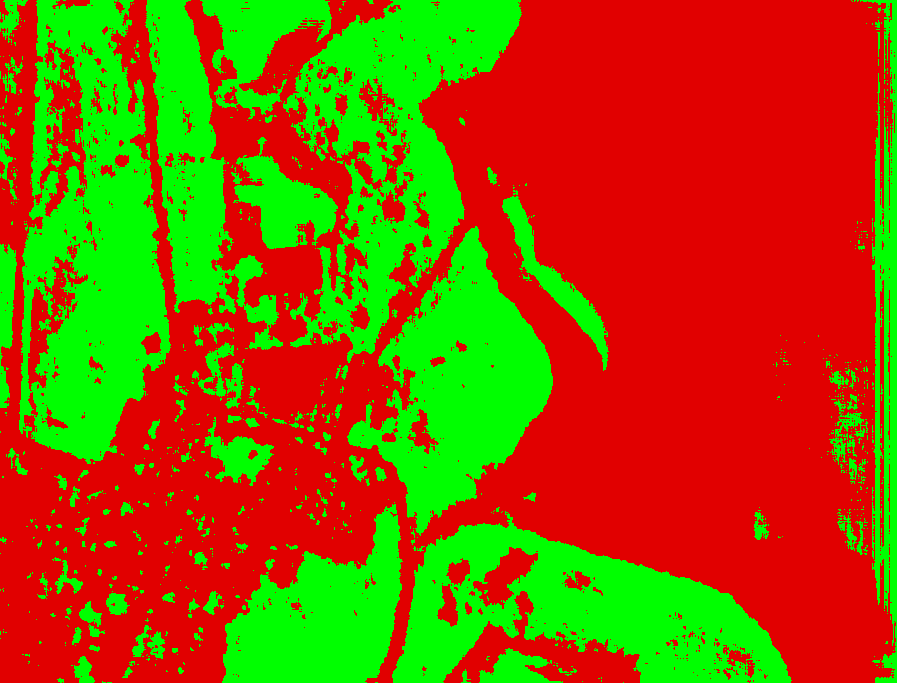

In [129]:
classified_image1

Carrega a imagem original para fazer a sobreposição dela com a pintada

In [130]:
path = os.path.abspath('./data/images/santa_helena_basemap_original.png')
original_image1 = PIL.Image.open(path).convert('RGB')

Aplica a sobreposição em 25%

In [131]:
blended_image1 = PIL.Image.blend(original_image1, classified_image1, 0.25)

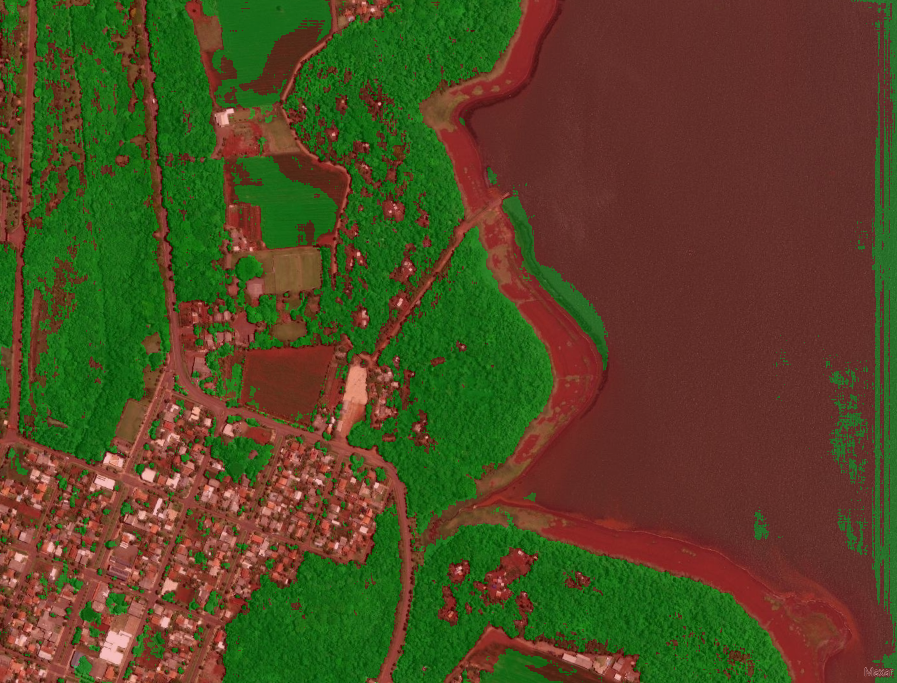

In [132]:
blended_image1

In [133]:
path = os.path.abspath('./data/dataset/results/')
name = 'classifier1_santa_helena_basemap'
blended_image1.save(path + name + f"_sobreposta.png")

#### Segunda imagem de exemplo de um local aleatório

In [134]:
classes_colors = {0:(225, 0, 0), 1:(0, 255, 0)}

a = Analyser(reconstructed_model, classes_colors, 64)
path = os.path.abspath('./data/images/basemap5_original.png')

classified_image2 = a.analyse(path, 10000)

2024-05-13 01:21:11.600784
2024-05-13 01:21:11.633782 - Running batch 1/52
2024-05-13 01:21:11.633782 - Chopping...
2024-05-13 01:21:12.344783 - Chopping completed.
2024-05-13 01:21:12.345783 - Predicting classes...
313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
2024-05-13 01:21:14.629345 - Prediction completed.
2024-05-13 01:21:14.647342 - Prediction completed.
2024-05-13 01:21:14.647342 - Running batch 2/52
2024-05-13 01:21:14.647342 - Chopping...
2024-05-13 01:21:16.064596 - Chopping completed.
2024-05-13 01:21:16.064596 - Predicting classes...
313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
2024-05-13 01:21:18.416004 - Prediction completed.
2024-05-13 01:21:18.436004 - Prediction completed.
2024-05-13 01:21:18.436004 - Running batch 3/52
2024-05-13 01:21:18.436004 - Chopping...
2024-05-13 01:21:19.706362 - Chopping completed.
2024-05-13 01:21:19.707362 - Predicting classes...
313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
2024-05-13 01:21:21.868368 - Prediction completed.
2024-05-13 01:21:21.887513 -

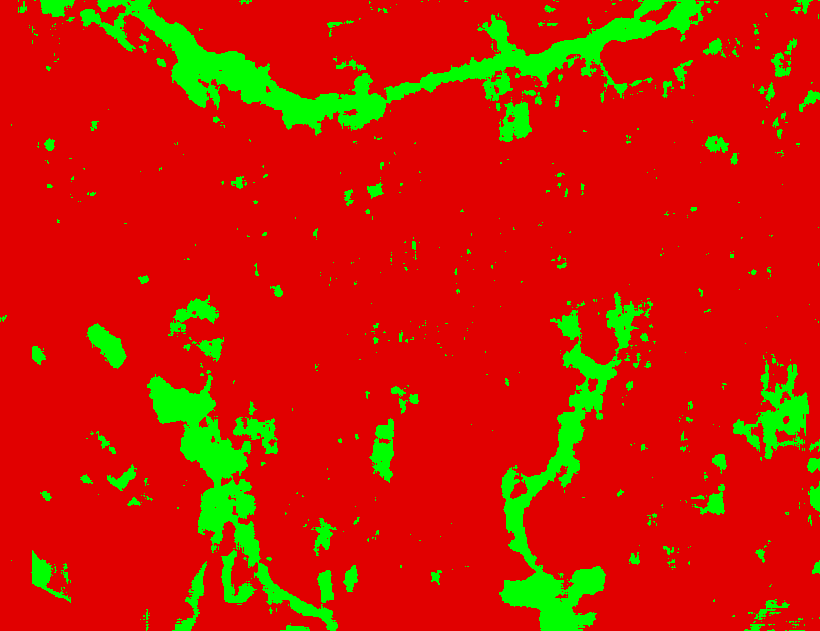

In [135]:
classified_image2

In [136]:
path = os.path.abspath('./data/dataset/results/')
name = 'classifier1_basemap5'
classified_image2.save(path + name + f"_segmentada.png")

In [137]:
path = os.path.abspath('./data/images/basemap5_original.png')
original_image2 = PIL.Image.open(path).convert('RGB')

In [138]:
blended_image2 = PIL.Image.blend(original_image2, classified_image2, 0.25)

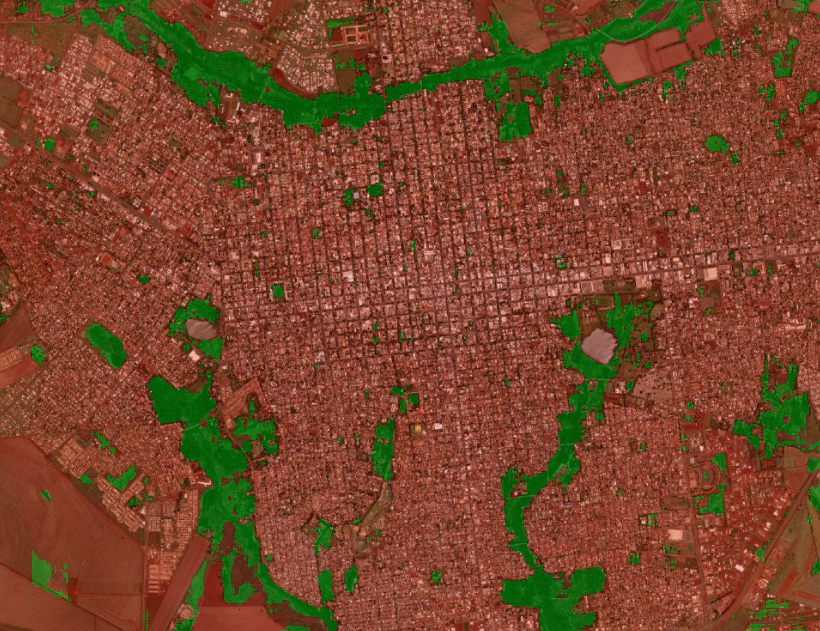

In [139]:
blended_image2

In [140]:
path = os.path.abspath('./data/dataset/results/')
name = 'classifier1_basemap5'
blended_image2.save(path + name + f"_blended.png")

## Segundo modelo de teste

Adicionei Regularização L2, diminuí a taxa de dropout para 30% e o batch_size para 32

In [ ]:
classifier = Sequential()

# Operador de convolução
classifier.add(Conv2D(32, (3,3), input_shape=(64,64,3), activation='relu'))
classifier.add(BatchNormalization())
classifier.add(MaxPooling2D(pool_size=(3,3)))

# Flattening
classifier.add(Flatten())

# Rede neural densa
classifier.add(Dense(units=64, activation='relu', kernel_regularizer=l2(0.01)))
classifier.add(Dropout(0.3))
classifier.add(Dense(units=2, activation='sigmoid'))

classifier.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

history2 = classifier.fit(prev_train, class_train, batch_size=32, epochs=10, validation_data=(prev_test, class_test))

c:\Workspaces\vivi-tcc\.venv\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:99: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(


Epoch 1/10
8152/8152 ━━━━━━━━━━━━━━━━━━━━ 650s 79ms/step - accuracy: 0.9210 - loss: 0.3434 - val_accuracy: 0.9407 - val_loss: 0.2289
Epoch 2/10
8152/8152 ━━━━━━━━━━━━━━━━━━━━ 513s 63ms/step - accuracy: 0.9362 - loss: 0.2452 - val_accuracy: 0.9314 - val_loss: 0.2410
Epoch 3/10
8152/8152 ━━━━━━━━━━━━━━━━━━━━ 485s 59ms/step - accuracy: 0.9379 - loss: 0.2387 - val_accuracy: 0.9475 - val_loss: 0.2133
Epoch 4/10
8152/8152 ━━━━━━━━━━━━━━━━━━━━ 418s 51ms/step - accuracy: 0.9380 - loss: 0.2391 - val_accuracy: 0.9491 - val_loss: 0.2059
Epoch 5/10
8152/8152 ━━━━━━━━━━━━━━━━━━━━ 460s 56ms/step - accuracy: 0.9404 - loss: 0.2326 - val_accuracy: 0.9462 - val_loss: 0.2088
Epoch 6/10
8152/8152 ━━━━━━━━━━━━━━━━━━━━ 444s 54ms/step - accuracy: 0.9412 - loss: 0.2274 - val_accuracy: 0.9447 - val_loss: 0.2241
Epoch 7/10
8152/8152 ━━━━━━━━━━━━━━━━━━━━ 456s 56ms/step - accuracy: 0.9408 - loss: 0.2261 - val_accuracy: 0.9509 - val_loss: 0.1950
Epoch 8/10
8152/8152 ━━━━━━━━━━━━━━━━━━━━ 444s 54ms/step - accuracy: 

In [ ]:
classifier.summary()

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_2 (Conv2D)               │ (None, 62, 62, 32)     │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 62, 62, 32)     │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 20, 20, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_2 (Flatten)             │ (None, 12800)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 64)             │       819,264 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 2)              │           130 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,461,128 (9.39 MB)

 Trainable params: 820,354 (3.13 MB)

 Non-trainable params: 64 (256.00 B)

 Optimizer params: 1,640,710 (6.26 MB)

In [ ]:
_, train_acc = classifier.evaluate(prev_train, class_train, verbose=0)
_, test_acc = classifier.evaluate(prev_test, class_test, verbose=0)
print('Train: %.4f, Test: %.4f' % (train_acc, test_acc))

Train: 0.9509, Test: 0.9503


In [ ]:
history2.history['accuracy']

[0.928398072719574,
 0.9362801909446716,
 0.9379439949989319,
 0.9389330744743347,
 0.9411336183547974,
 0.9411182999610901,
 0.940964937210083,
 0.9408575892448425,
 0.941865861415863,
 0.9419386982917786]

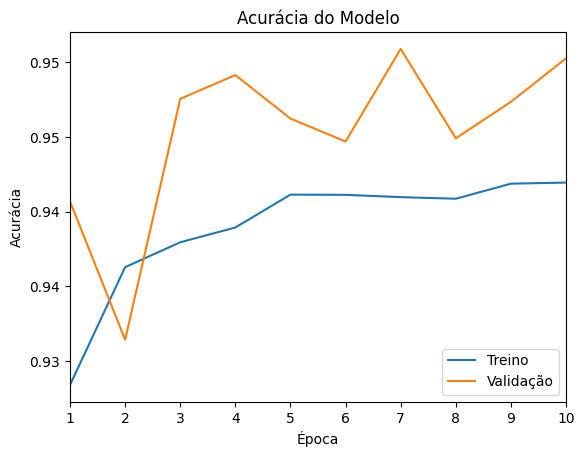

In [ ]:
labels = ['1', '2', '3', '4', '5', '6', '7', '8', '9', '10']

plt.plot(history2.history['accuracy'], label='Treino')
plt.plot(history2.history['val_accuracy'], label='Validação')
plt.title('Acurácia do Modelo')
plt.xlabel('Época')
plt.ylabel('Acurácia')
plt.legend(loc='lower right')
# plt.ylim(0.8, 1)
plt.xlim(0, 9)

formatter = mticker.FuncFormatter(lambda x, pos: "{:.2f}".format(x))
plt.gca().yaxis.set_major_formatter(formatter)
plt.xticks(range(0, 10), labels)


plt.show()

In [ ]:
path = os.path.abspath('./data/dataset/classifier2.keras')

classifier.save(path)

### Segmentação das imagens

In [ ]:
reconstructed_model = tf.keras.models.load_model(path)

In [11]:
# Retorna as coordenadas de uma bounding box ao redor da posição com o tamanho especificado
def box(position, size):
    
    x, y = position
    left = x - size // 2
    upper = y - size // 2
    right = left + size
    lower = upper + size
    return (left, upper, right, lower)

# Para cada pixel da imagem, cria uma bounding box ao redor desse pixel e recorta a imagem
def subimages(image, box_size):
    
    width, height = image.size
    for x in range(width):
        for y in range(height):
            position = x, y
            bouding_box = box(position, box_size)
            yield image.crop(bouding_box)

# Para cada pixel da imagem, define a cor desse pixel para a próxima cor na sequência
def colorize(image, colors):
    
    width, height = image.size
    i = iter(colors)
    for x in range(width):
        for y in range(height):
            position = x, y
            try:
                color = next(i)
            except:
                return
            image.putpixel(position, color)

# Recebe uma lista de previsões e retorna uma lista de classes, mapeando a função prediction2class para cada previsão na lista

def prediction2class(prediction):
    return sorted(enumerate([i for i in prediction]), key=lambda x: x[1])[-1][0]

def predictions2classes(predictions):
    return list(map(prediction2class, predictions))


class Analyser:
    
    def __init__(self, neural_net, classes_colors, box_size):
        # Inicializa a classe com a rede neural, as cores das classes e o tamanho da bounding box 
        self.neural_net = neural_net
        self.classes_colors = classes_colors
        self.box_size = box_size
        self.image = None

    def analyse(self, image, batch_size = -1):
        # Imprime a data e hora atual
        print(f"{datetime.datetime.now()}")

        # Abre a imagem e converte para RGB
        if isinstance(image, str):
            image = Image.open(image).convert('RGB')
        self.image = image

        # Obtém a largura e a altura da imagem
        width, height = image.size
        counter = width*height

        # Cria uma nova imagem com o mesmo tamanho da imagem original
        self.classified_image = Image.new("RGB", image.size)

        # Se o tamanho do lote for menor que 0, define o tamanho do lote como o contador
        if batch_size < 0:
            batch_size = counter

        # Cria subimagens da imagem original
        iter_images = subimages(image, self.box_size)

        # Inicializa as listas e classes de previsões
        self.predictions = []
        self.predictions_classes = []

        # Inicializa o contador de lotes e o número máximo de lotes
        batch_counter = 1
        max_batches = math.ceil(counter / batch_size)

        try:
            
            while counter > 0:
                
                print(f"{datetime.datetime.now()} - Rodando o lote {batch_counter}/{max_batches}")
                batch_counter += 1
                
                print(f"{datetime.datetime.now()} - Cortando")
                images = [np.array(next(iter_images), dtype=np.float32)/255 for i in range(min(batch_size, counter))]
                X = np.array(images)

                print(f"{datetime.datetime.now()} - Corte Completo")

                print(f"{datetime.datetime.now()} - Prevendo as classes")
                predictions = self.neural_net.predict(X)

                print(f"{datetime.datetime.now()} - Previsao completa")

                # Adiciona as classes previstas à lista
                self.predictions_classes.extend(predictions2classes(predictions))
               
                print(f"{datetime.datetime.now()} - Completo")

                # Diminui o contador pelo tamanho do lote
                counter -= batch_size

        #Imprime a data e hora atual e a exceção
        except Exception as e:
            print(f"{datetime.datetime.now()} - Erro {e}")

        print(f"{datetime.datetime.now()} - Colorindo a imagem final")

        # Mapeia as cores das classes para as classes previstas e pinta a imagem
        colors = map(self.classes_colors.get, self.predictions_classes)
        colorize(self.classified_image, colors)

        print(f"{datetime.datetime.now()} - Acabou")

        return self.classified_image

#### Primeira imagem de exemplo (Santa Helena - 23/09/18)

In [ ]:
classes_colors = {0:(225, 0, 0), 1:(0, 255, 0)}
a = Analyser(reconstructed_model, classes_colors, 64)

path = os.path.abspath('./data/images/santa_helena_basemap_original.png')
classified_image1 = a.analyse(path, 5000)

2024-04-03 18:02:30.090604
2024-04-03 18:02:30.341601 - Running batch 1/123
2024-04-03 18:02:30.341601 - Chopping...
2024-04-03 18:02:30.850601 - Chopping completed.
2024-04-03 18:02:30.850601 - Predicting classes...
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
2024-04-03 18:02:32.487832 - Prediction completed.
2024-04-03 18:02:32.496831 - Prediction completed.
2024-04-03 18:02:32.496831 - Running batch 2/123
2024-04-03 18:02:32.496831 - Chopping...
2024-04-03 18:02:33.227433 - Chopping completed.
2024-04-03 18:02:33.228435 - Predicting classes...
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
2024-04-03 18:02:34.468907 - Prediction completed.
2024-04-03 18:02:34.477908 - Prediction completed.
2024-04-03 18:02:34.477908 - Running batch 3/123
2024-04-03 18:02:34.477908 - Chopping...
2024-04-03 18:02:35.161279 - Chopping completed.
2024-04-03 18:02:35.162279 - Predicting classes...
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
2024-04-03 18:02:36.421508 - Prediction completed.
2024-04-03 18:02:36.43151

In [ ]:
path = os.path.abspath('./data/images/')
name = 'classifier2_balanced_santa_helena_basemap'
classified_image1.save(path + name + f"_segmentada.png")

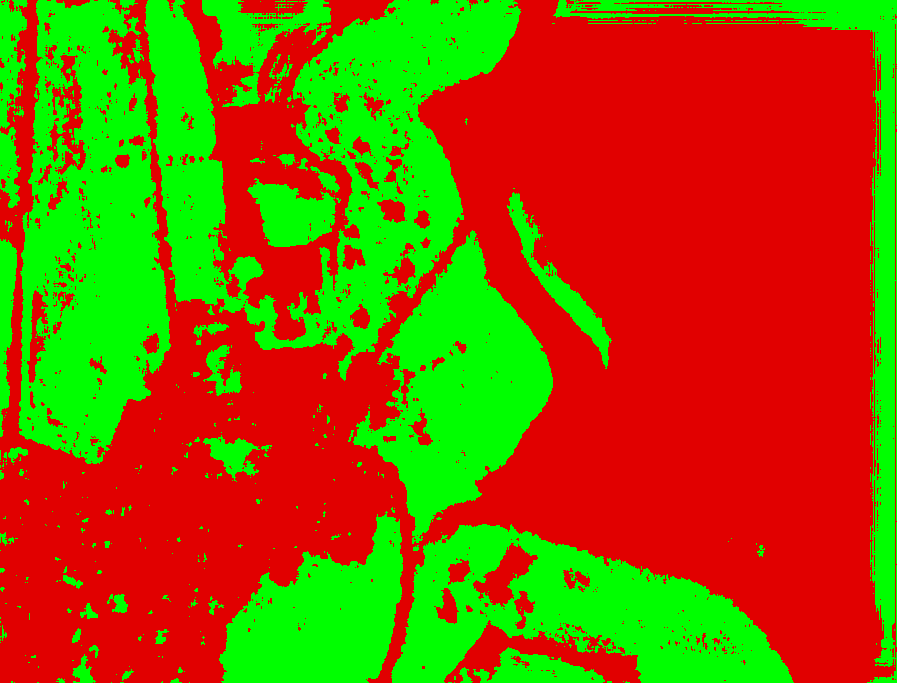

In [ ]:
classified_image1

In [ ]:
path = os.path.abspath('./data/images/santa_helena_basemap_original.png')
original_image1 = PIL.Image.open(path).convert('RGB')

In [ ]:
path = os.path.abspath('./data/images/')
name = 'santa_helena_basemap'
original_image1.save(path + name + f"_original.png")

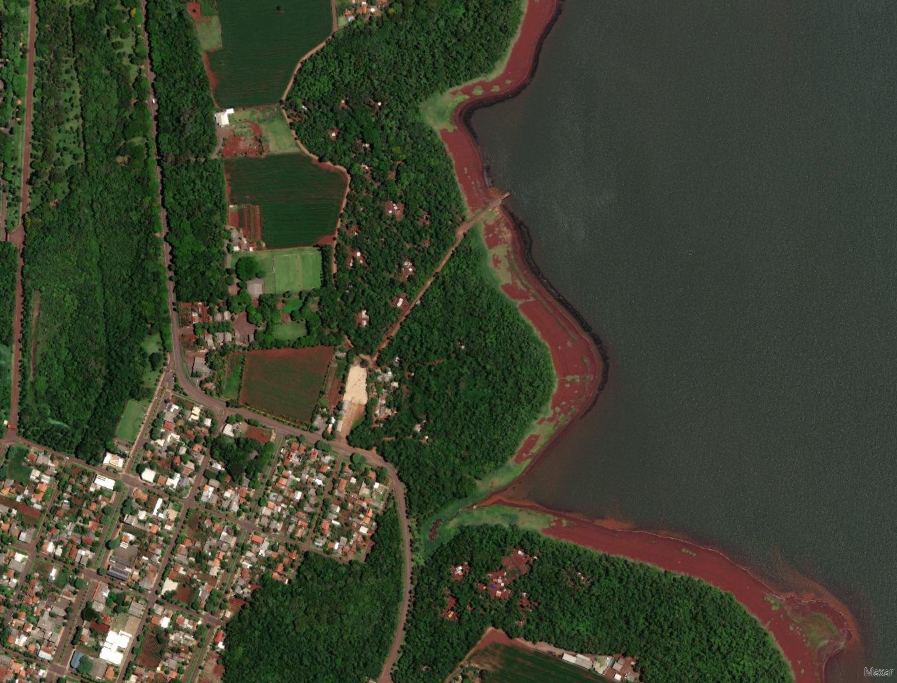

In [ ]:
original_image1

In [ ]:
blended_image1 = PIL.Image.blend(original_image1, classified_image1, 0.25)

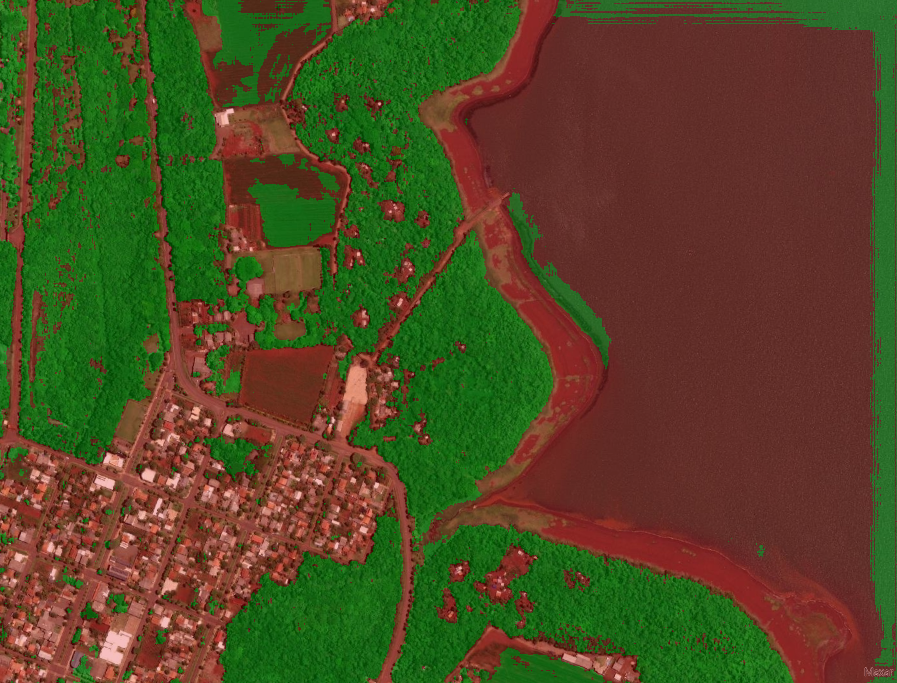

In [ ]:
blended_image1

In [ ]:
path = os.path.abspath('./data/images/')
name = 'classifier2_santa_helena_basemap'
blended_image1.save(path + name + f"_sobreposta.png")

#### Segunda imagem de exemplo de um local aleatório

In [ ]:
classes_colors = {0:(225, 0, 0), 1:(0, 255, 0)}

a = Analyser(reconstructed_model, classes_colors, 64)
path = os.path.abspath('./data/images/basemap5_original.png')

classified_image2 = a.analyse(path, 10000)

2024-04-03 18:12:15.686631
2024-04-03 18:12:15.702626 - Running batch 1/52
2024-04-03 18:12:15.702626 - Chopping...
2024-04-03 18:12:16.515961 - Chopping completed.
2024-04-03 18:12:16.515961 - Predicting classes...
313/313 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step
2024-04-03 18:12:19.435960 - Prediction completed.
2024-04-03 18:12:19.456959 - Prediction completed.
2024-04-03 18:12:19.456959 - Running batch 2/52
2024-04-03 18:12:19.456959 - Chopping...
2024-04-03 18:12:20.606959 - Chopping completed.
2024-04-03 18:12:20.606959 - Predicting classes...
313/313 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
2024-04-03 18:12:23.952189 - Prediction completed.
2024-04-03 18:12:23.972181 - Prediction completed.
2024-04-03 18:12:23.972181 - Running batch 3/52
2024-04-03 18:12:23.972181 - Chopping...
2024-04-03 18:12:25.220182 - Chopping completed.
2024-04-03 18:12:25.220182 - Predicting classes...
313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
2024-04-03 18:12:27.880982 - Prediction completed.
2024-04-03 18:12:27.903985 

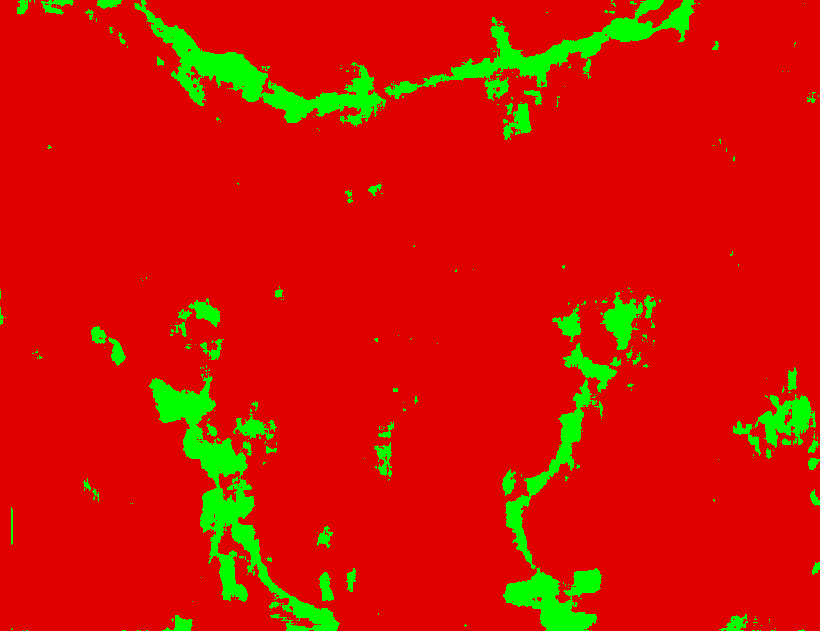

In [ ]:
classified_image2

In [ ]:
path = os.path.abspath('./data/images/')
name = 'basemap5'
classified_image2.save(path + name + f"_segmentada.png")

In [ ]:
path = os.path.abspath('./data/images/basemap5_original.png')
original_image2 = PIL.Image.open(path).convert('RGB')

In [ ]:
path = os.path.abspath('./data/images/')
name = 'basemap5'
original_image2.save(path + name + f"_original1.png")

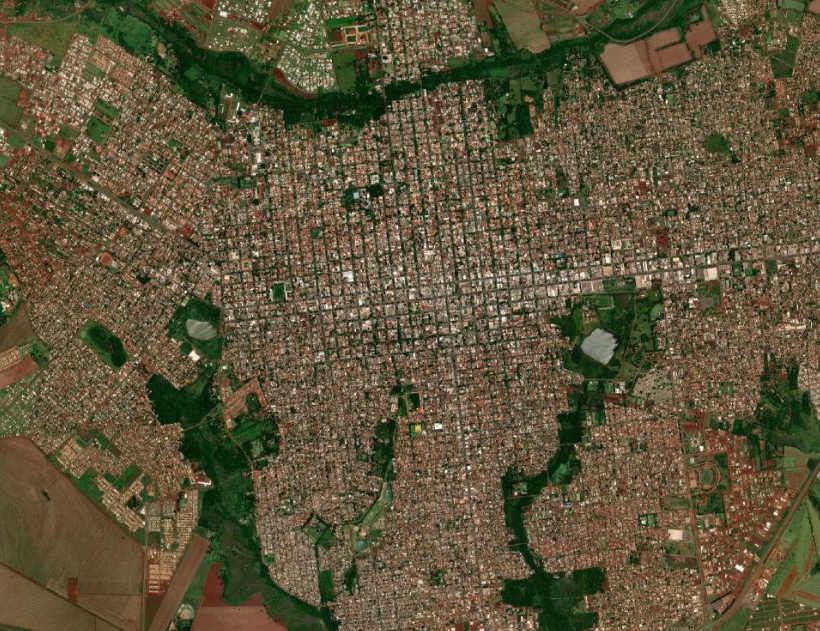

In [ ]:
original_image2

In [ ]:
blended_image2 = PIL.Image.blend(original_image2, classified_image2, 0.25)

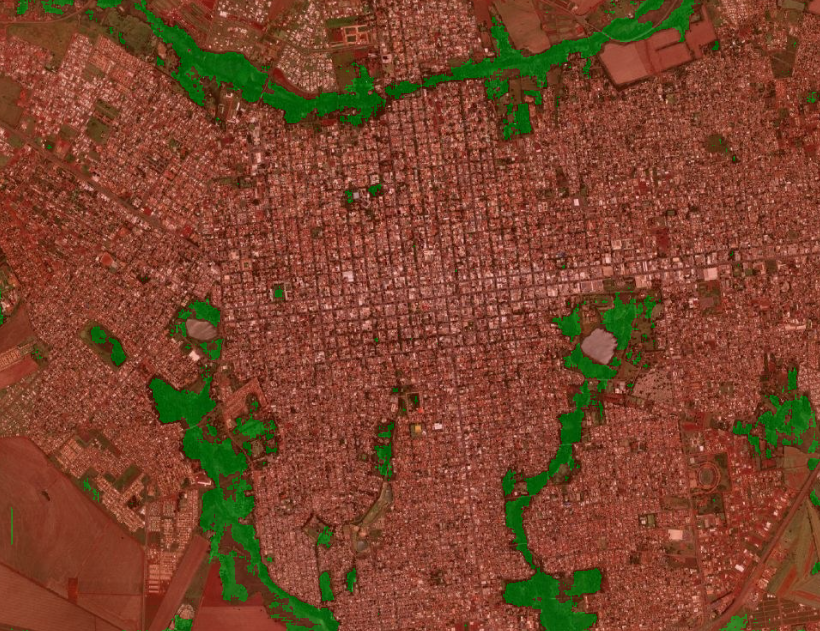

In [ ]:
blended_image2

In [ ]:
path = os.path.abspath('./data/images/')
name = 'basemap5'
blended_image2.save(path + name + f"_blended.png")

## Terceiro modelo de teste

Teste: Refiz o dataset (dataset_tcc)

In [ ]:
classifier = Sequential()

# Operador de convolução
classifier.add(Conv2D(32, (3,3), input_shape=(64,64,3), activation='relu'))
classifier.add(BatchNormalization())
classifier.add(MaxPooling2D(pool_size=(3,3)))

# Flattening
classifier.add(Flatten())

# Rede neural densa
classifier.add(Dense(units=64, activation='relu', kernel_regularizer=l2(0.01)))
classifier.add(Dropout(0.3))
classifier.add(Dense(units=2, activation='sigmoid'))

classifier.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

history3 = classifier.fit(prev_train, class_train, batch_size=32, epochs=10, validation_data=(prev_test, class_test))

c:\Workspaces\vivi-tcc\.venv\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:99: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(


Epoch 1/10
7392/7392 ━━━━━━━━━━━━━━━━━━━━ 474s 64ms/step - accuracy: 0.8457 - loss: 0.5401 - val_accuracy: 0.8754 - val_loss: 0.4140
Epoch 2/10
7392/7392 ━━━━━━━━━━━━━━━━━━━━ 348s 47ms/step - accuracy: 0.8715 - loss: 0.4062 - val_accuracy: 0.8849 - val_loss: 0.3723
Epoch 3/10
7392/7392 ━━━━━━━━━━━━━━━━━━━━ 349s 47ms/step - accuracy: 0.8742 - loss: 0.3946 - val_accuracy: 0.8811 - val_loss: 0.3763
Epoch 4/10
7392/7392 ━━━━━━━━━━━━━━━━━━━━ 347s 47ms/step - accuracy: 0.8743 - loss: 0.3911 - val_accuracy: 0.8845 - val_loss: 0.3611
Epoch 5/10
7392/7392 ━━━━━━━━━━━━━━━━━━━━ 343s 46ms/step - accuracy: 0.8759 - loss: 0.3856 - val_accuracy: 0.8731 - val_loss: 0.4134
Epoch 6/10
7392/7392 ━━━━━━━━━━━━━━━━━━━━ 356s 48ms/step - accuracy: 0.8768 - loss: 0.3801 - val_accuracy: 0.8640 - val_loss: 0.3911
Epoch 7/10
7392/7392 ━━━━━━━━━━━━━━━━━━━━ 349s 47ms/step - accuracy: 0.8790 - loss: 0.3789 - val_accuracy: 0.8943 - val_loss: 0.3428
Epoch 8/10
7392/7392 ━━━━━━━━━━━━━━━━━━━━ 330s 45ms/step - accuracy: 

In [ ]:
classifier.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 62, 62, 32)     │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 62, 62, 32)     │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 20, 20, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 12800)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 64)             │       819,264 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 2)              │           130 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,461,128 (9.39 MB)

 Trainable params: 820,354 (3.13 MB)

 Non-trainable params: 64 (256.00 B)

 Optimizer params: 1,640,710 (6.26 MB)

In [ ]:
_, train_acc = classifier.evaluate(prev_train, class_train, verbose=0)
_, test_acc = classifier.evaluate(prev_test, class_test, verbose=0)
print('Train: %.4f, Test: %.4f' % (train_acc, test_acc))

Train: 0.8941, Test: 0.8930


In [ ]:
history3.history['accuracy']

[0.8601315021514893,
 0.8727649450302124,
 0.8745872378349304,
 0.8761135935783386,
 0.8768154382705688,
 0.877449631690979,
 0.8782233595848083,
 0.8788575530052185,
 0.8789379000663757,
 0.878646194934845]

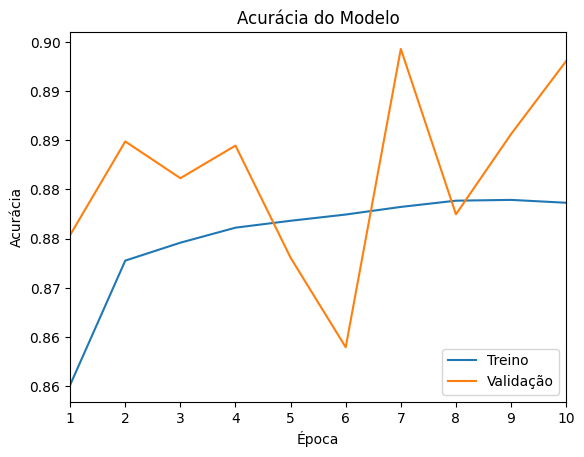

In [ ]:
labels = ['1', '2', '3', '4', '5', '6', '7', '8', '9', '10']

plt.plot(history3.history['accuracy'], label='Treino')
plt.plot(history3.history['val_accuracy'], label='Validação')

plt.title('Acurácia do Modelo')
plt.xlabel('Época')
plt.ylabel('Acurácia')
plt.legend(loc='lower right')
# plt.ylim(0.8, 1)
plt.xlim(0, 9)

formatter = mticker.FuncFormatter(lambda x, pos: "{:.2f}".format(x))
plt.gca().yaxis.set_major_formatter(formatter)
plt.xticks(range(0, 10), labels)


plt.show()

In [ ]:
path = os.path.abspath('./data/dataset_tcc/classifier3.keras')

classifier.save(path)

### Avaliação pelo coeficiente de Kappa e Matriz de confusão

In [ ]:
print(class_test.shape)

(65212,)


Como o class_test é um vetor one-hot encoded, precisa converter para vetor de rotulos de classe para poder avaliar com kappa e matriz de confusao

In [ ]:
path = os.path.abspath('./data/dataset_tcc/classifier3.keras')
reconstructed_model = tf.keras.models.load_model(path)

In [ ]:
# Converte class_test de one-hot encoded para rótulos de classe
class_test = np.argmax(class_test, axis=1)

# Faz previsões nos dados de validação
class_pred = reconstructed_model.predict(prev_test, batch_size=32)

# Converte as previsões para rótulos de classe
class_pred = np.argmax(class_pred, axis=1)

conf_mat = confusion_matrix(class_test, class_pred)

print("Matriz de Confusão:")
print(conf_mat)

kappa = cohen_kappa_score(class_test, class_pred)

print("\nCoeficiente de Kappa: ", kappa)

1848/1848 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step
Matriz de Confusão:
[[25438  3588]
 [ 1586 28517]]

Coeficiente de Kappa:  0.8247184654639526


### Segmentação das imagens

In [ ]:
# Retorna as coordenadas de uma bounding box ao redor da posição com o tamanho especificado
def box(position, size):
    
    x, y = position
    left = x - size // 2
    upper = y - size // 2
    right = left + size
    lower = upper + size
    return (left, upper, right, lower)

# Para cada pixel da imagem, cria uma bounding box ao redor desse pixel e recorta a imagem
def subimages(image, box_size):
    
    width, height = image.size
    for x in range(width):
        for y in range(height):
            position = x, y
            bouding_box = box(position, box_size)
            yield image.crop(bouding_box)

# Para cada pixel da imagem, define a cor desse pixel para a próxima cor na sequência
def colorize(image, colors):
    
    width, height = image.size
    i = iter(colors)
    for x in range(width):
        for y in range(height):
            position = x, y
            try:
                color = next(i)
            except:
                return
            image.putpixel(position, color)

# Recebe uma lista de previsões e retorna uma lista de classes, mapeando a função prediction2class para cada previsão na lista

def prediction2class(prediction):
    return sorted(enumerate([i for i in prediction]), key=lambda x: x[1])[-1][0]

def predictions2classes(predictions):
    return list(map(prediction2class, predictions))


class Analyser:
    
    def __init__(self, neural_net, classes_colors, box_size):
        # Inicializa a classe com a rede neural, as cores das classes e o tamanho da bounding box 
        self.neural_net = neural_net
        self.classes_colors = classes_colors
        self.box_size = box_size
        self.image = None

    def analyse(self, image, batch_size = -1):
        # Imprime a data e hora atual
        print(f"{datetime.datetime.now()}")

        # Abre a imagem e converte para RGB
        if isinstance(image, str):
            image = Image.open(image).convert('RGB')
        self.image = image

        # Obtém a largura e a altura da imagem
        width, height = image.size
        counter = width*height

        # Cria uma nova imagem com o mesmo tamanho da imagem original
        self.classified_image = Image.new("RGB", image.size)

        # Se o tamanho do lote for menor que 0, define o tamanho do lote como o contador
        if batch_size < 0:
            batch_size = counter

        # Cria subimagens da imagem original
        iter_images = subimages(image, self.box_size)

        # Inicializa as listas e classes de previsões
        self.predictions = []
        self.predictions_classes = []

        # Inicializa o contador de lotes e o número máximo de lotes
        batch_counter = 1
        max_batches = math.ceil(counter / batch_size)

        try:
            
            while counter > 0:
                
                print(f"{datetime.datetime.now()} - Rodando o lote {batch_counter}/{max_batches}")
                batch_counter += 1
                
                print(f"{datetime.datetime.now()} - Cortando")
                images = [np.array(next(iter_images), dtype=np.float32)/255 for i in range(min(batch_size, counter))]
                X = np.array(images)

                print(f"{datetime.datetime.now()} - Corte Completo")

                print(f"{datetime.datetime.now()} - Prevendo as classes")
                predictions = self.neural_net.predict(X)

                print(f"{datetime.datetime.now()} - Previsao completa")

                # Adiciona as classes previstas à lista
                self.predictions_classes.extend(predictions2classes(predictions))
               
                print(f"{datetime.datetime.now()} - Completo")

                # Diminui o contador pelo tamanho do lote
                counter -= batch_size

        #Imprime a data e hora atual e a exceção
        except Exception as e:
            print(f"{datetime.datetime.now()} - Erro {e}")

        print(f"{datetime.datetime.now()} - Colorindo a imagem final")

        # Mapeia as cores das classes para as classes previstas e pinta a imagem
        colors = map(self.classes_colors.get, self.predictions_classes)
        colorize(self.classified_image, colors)

        print(f"{datetime.datetime.now()} - Acabou")

        return self.classified_image

#### Primeira imagem de exemplo (Santa Helena - 23/09/18)

In [ ]:
classes_colors = {0:(225, 0, 0), 1:(0, 255, 0)}
a = Analyser(reconstructed_model, classes_colors, 64)

path = os.path.abspath('./data/images/santa_helena_basemap_original.png')
classified_image1 = a.analyse(path, 5000)

2024-05-08 23:56:09.991249
2024-05-08 23:56:10.070274 - Running batch 1/123
2024-05-08 23:56:10.070274 - Chopping...
2024-05-08 23:56:10.571610 - Chopping completed.
2024-05-08 23:56:10.571610 - Predicting classes...
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
2024-05-08 23:56:12.134845 - Prediction completed.
2024-05-08 23:56:12.144845 - Prediction completed.
2024-05-08 23:56:12.144845 - Running batch 2/123
2024-05-08 23:56:12.144845 - Chopping...
2024-05-08 23:56:12.683409 - Chopping completed.
2024-05-08 23:56:12.683409 - Predicting classes...
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
2024-05-08 23:56:13.840186 - Prediction completed.
2024-05-08 23:56:13.849185 - Prediction completed.
2024-05-08 23:56:13.849185 - Running batch 3/123
2024-05-08 23:56:13.849185 - Chopping...
2024-05-08 23:56:14.363199 - Chopping completed.
2024-05-08 23:56:14.363199 - Predicting classes...
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
2024-05-08 23:56:15.542442 - Prediction completed.
2024-05-08 23:56:15.55344

In [ ]:
path = os.path.abspath('./data/dataset_tcc/results/')
name = 'classifier3_santa_helena_basemap'
classified_image1.save(path + '\\' + name + f"_segmentada.png")

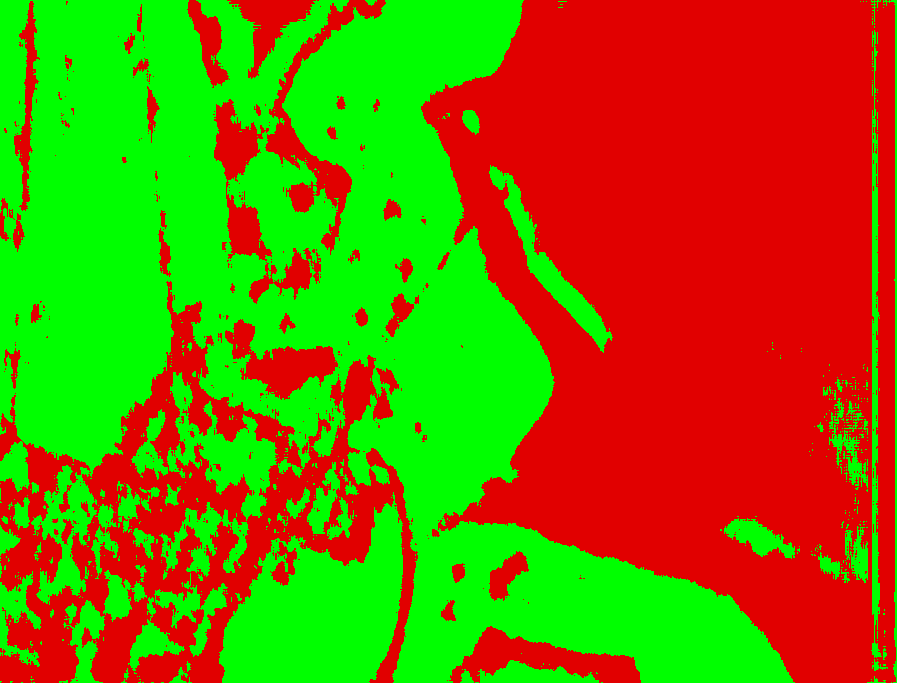

In [ ]:
classified_image1

In [ ]:
path = os.path.abspath('./data/images/santa_helena_basemap_original.png')
original_image1 = PIL.Image.open(path).convert('RGB')

In [ ]:
path = os.path.abspath('./data/dataset_tcc/results/')
name = 'classifier3_santa_helena_basemap'
original_image1.save(path + '\\' + name + f"_original.png")

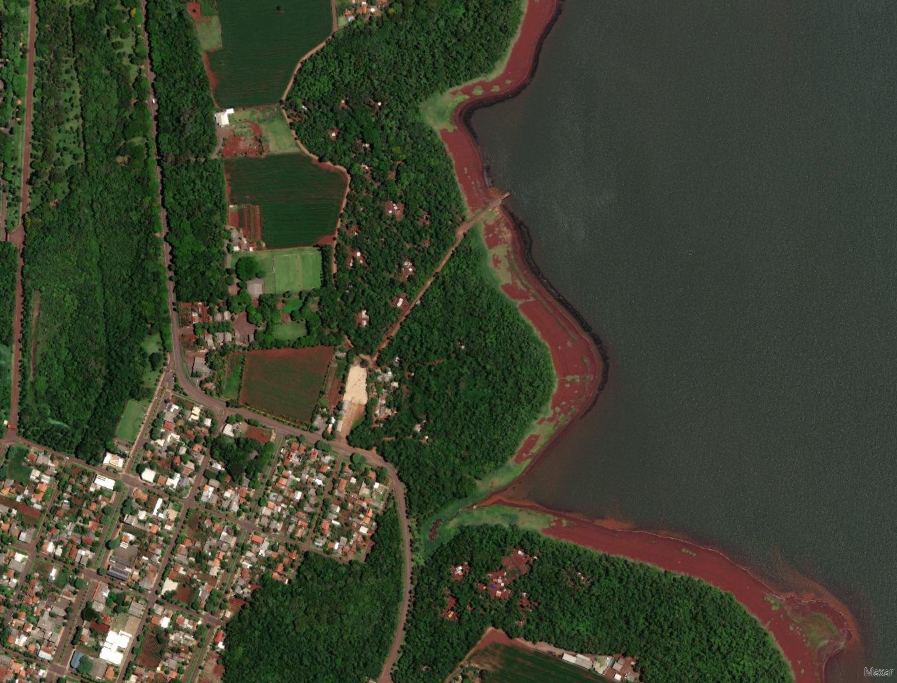

In [ ]:
original_image1

In [ ]:
blended_image1 = PIL.Image.blend(original_image1, classified_image1, 0.25)

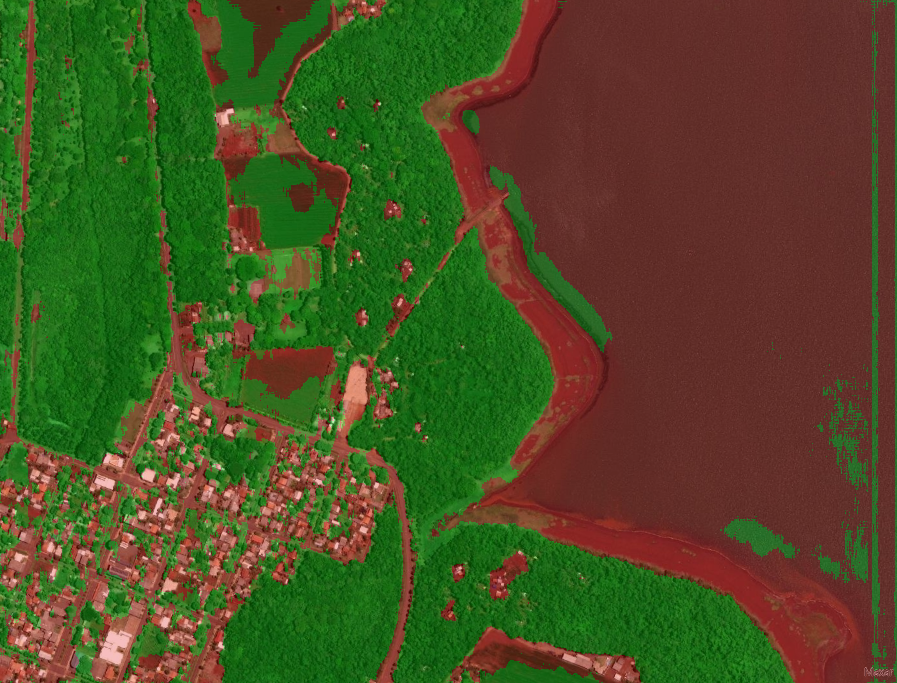

In [ ]:
blended_image1

In [ ]:
path = os.path.abspath('./data/dataset_tcc/results/')
name = 'classifier3_santa_helena_basemap'
blended_image1.save(path + '\\' + name + f"_sobreposta.png")

#### Segunda imagem de exemplo de um local aleatório

In [ ]:
classes_colors = {0:(225, 0, 0), 1:(0, 255, 0)}

a = Analyser(reconstructed_model, classes_colors, 64)
path = os.path.abspath('./data/images/basemap5_original.png')

classified_image2 = a.analyse(path, 10000)

2024-05-08 23:59:30.206776
2024-05-08 23:59:30.242775 - Running batch 1/52
2024-05-08 23:59:30.242775 - Chopping...
2024-05-08 23:59:30.935776 - Chopping completed.
2024-05-08 23:59:30.935776 - Predicting classes...
313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
2024-05-08 23:59:33.485774 - Prediction completed.
2024-05-08 23:59:33.503775 - Prediction completed.
2024-05-08 23:59:33.503775 - Running batch 2/52
2024-05-08 23:59:33.503775 - Chopping...
2024-05-08 23:59:34.418775 - Chopping completed.
2024-05-08 23:59:34.419777 - Predicting classes...
313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
2024-05-08 23:59:36.853774 - Prediction completed.
2024-05-08 23:59:36.872775 - Prediction completed.
2024-05-08 23:59:36.872775 - Running batch 3/52
2024-05-08 23:59:36.872775 - Chopping...
2024-05-08 23:59:37.826774 - Chopping completed.
2024-05-08 23:59:37.827774 - Predicting classes...
313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
2024-05-08 23:59:40.375774 - Prediction completed.
2024-05-08 23:59:40.394775 -

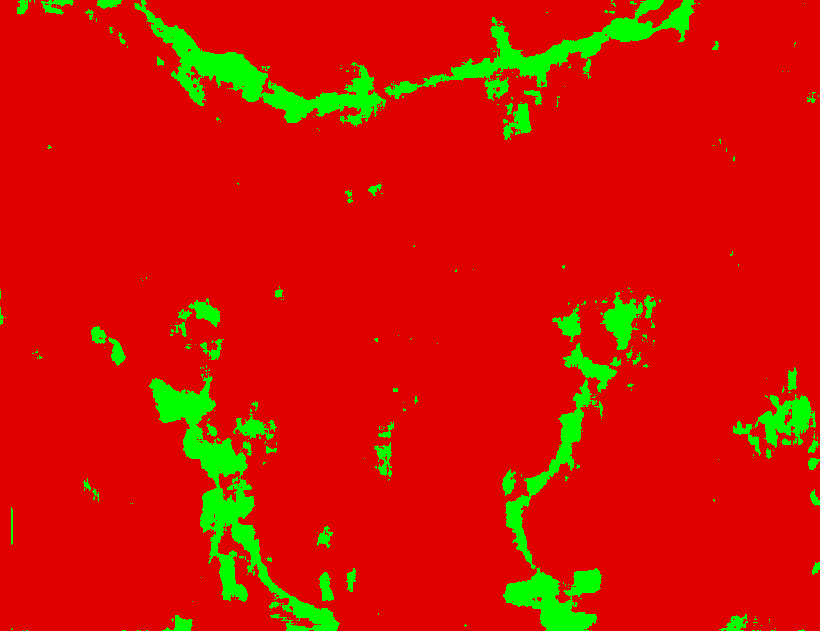

In [ ]:
classified_image2

In [ ]:
path = os.path.abspath('./data/dataset_tcc/results/')
name = 'classifier3_basemap5'
classified_image2.save(path + '\\' + name + f"_segmentada.png")

In [ ]:
path = os.path.abspath('./data/images/basemap5_original.png')
original_image2 = PIL.Image.open(path).convert('RGB')

In [ ]:
path = os.path.abspath('./data/dataset_tcc/results/')
name = 'classifier3_basemap5'
original_image2.save(path + '\\' + name + f"_original1.png")

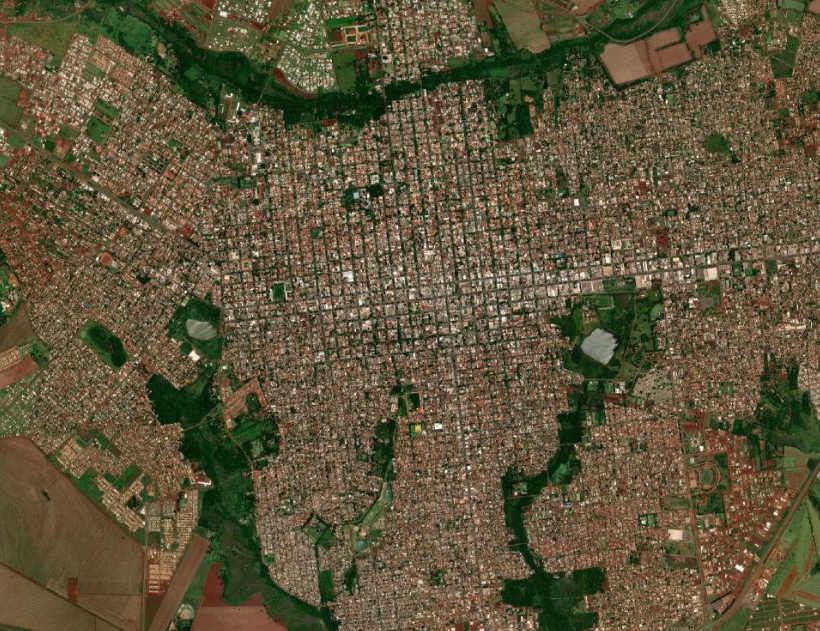

In [ ]:
original_image2

In [ ]:
blended_image2 = PIL.Image.blend(original_image2, classified_image2, 0.25)

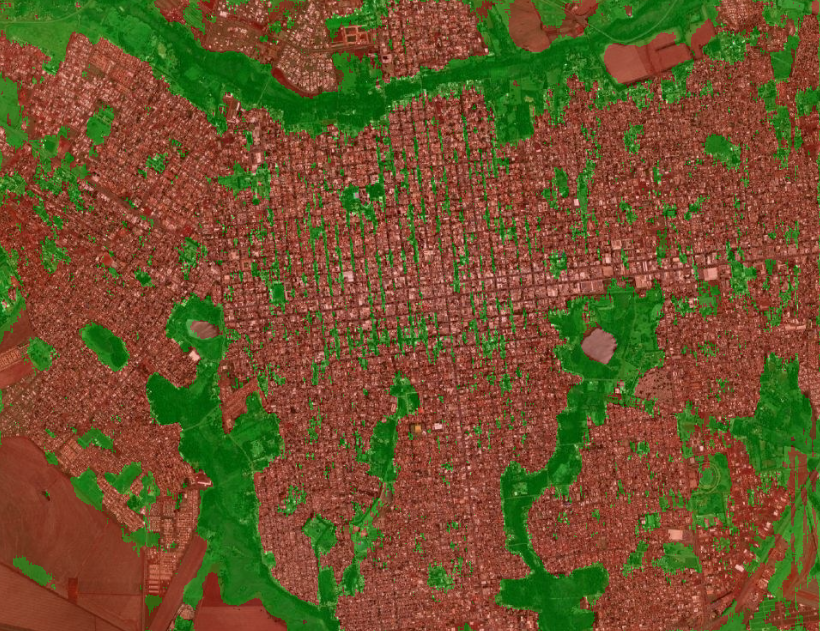

In [ ]:
blended_image2

In [ ]:
path = os.path.abspath('./data/dataset_tcc/results/')
name = 'classifier3_basemap5'
blended_image2.save(path + '\\' + name + f"_blended.png")

# Quarto modelo de teste

Adicionei o Data Augmentation

In [73]:
path = os.path.abspath('./data/dataset_tcc/classifier2.keras')
reconstructed_model = tf.keras.models.load_model(path)

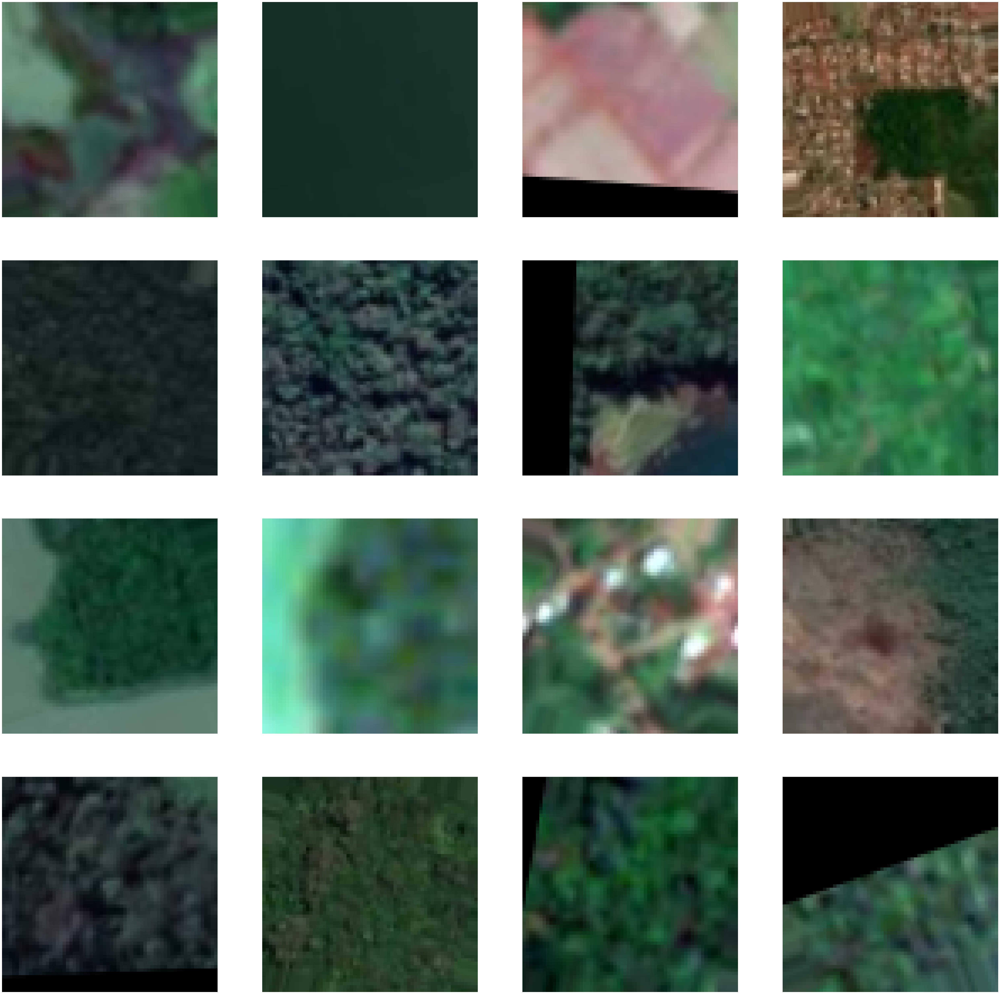

In [ ]:
# Exibe algumas imagens aumentadas
images = next(data_generator_aug)[0]

# Exibe as imagens em uma grade 4x4 com o matplotlib
nrows = 4
ncols = 4
fig = plt.figure(figsize=(64,64))

for i in range(16):
  fig.add_subplot(nrows, ncols, i+1)
  plt.imshow((images[i]*255).astype('uint8'))  # Multiplica os dados da imagem por 255 antes de convertê-los para uint8
  plt.axis(False)

plt.show()

In [70]:
batch_size = 64  # Aumenta o tamanho do batch
epochs = 5  # Reduz o número de épocas

datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest')

# Ajusta o gerador de data augmentation aos seus dados de treinamento
datagen.fit(prev_train)

# Treina o modelo com data augmentation
history4 = reconstructed_model.fit(datagen.flow(prev_train, class_train, batch_size=batch_size),
                 steps_per_epoch=math.ceil(len(prev_train) / batch_size), epochs=epochs, validation_data=(prev_test, class_test)) 

Epoch 1/5
3696/3696 ━━━━━━━━━━━━━━━━━━━━ 696s 186ms/step - accuracy: 0.8326 - loss: 0.4384 - val_accuracy: 0.8543 - val_loss: 0.3840
Epoch 2/5
3696/3696 ━━━━━━━━━━━━━━━━━━━━ 12s 3ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8543 - val_loss: 0.3840
Epoch 3/5
3696/3696 ━━━━━━━━━━━━━━━━━━━━ 947s 256ms/step - accuracy: 0.8353 - loss: 0.4306 - val_accuracy: 0.8603 - val_loss: 0.3845
Epoch 4/5
3696/3696 ━━━━━━━━━━━━━━━━━━━━ 12s 3ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8603 - val_loss: 0.3845
Epoch 5/5
3696/3696 ━━━━━━━━━━━━━━━━━━━━ 770s 208ms/step - accuracy: 0.8338 - loss: 0.4329 - val_accuracy: 0.8711 - val_loss: 0.3691


In [71]:
path = os.path.abspath('./data/dataset_tcc/classifier4.keras')

reconstructed_model.save(path)

In [78]:
reconstructed_model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 62, 62, 32)     │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 62, 62, 32)     │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 20, 20, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 12800)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 64)             │       819,264 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 2)              │           130 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,461,128 (9.39 MB)

 Trainable params: 820,354 (3.13 MB)

 Non-trainable params: 64 (256.00 B)

 Optimizer params: 1,640,710 (6.26 MB)

In [79]:
_, train_acc = reconstructed_model.evaluate(prev_train, class_train, verbose=0)
_, test_acc = reconstructed_model.evaluate(prev_test, class_test, verbose=0)
print('Train: %.4f, Test: %.4f' % (train_acc, test_acc))

Train: 0.8724, Test: 0.8711


In [80]:
history4.history['accuracy']

TypeError: 'History' object is not subscriptable

In [ ]:
labels = ['1', '2', '3', '4', '5', '6', '7', '8', '9', '10']

plt.plot(history4.history['accuracy'], label='Treino')
plt.plot(history4.history['val_accuracy'], label='Validação')
plt.title('Acurácia do Modelo')
plt.xlabel('Época') 
plt.ylabel('Acurácia')
plt.legend(loc='lower right')
# plt.ylim(0.8, 1)
plt.xlim(0, 9)

formatter = mticker.FuncFormatter(lambda x, pos: "{:.2f}".format(x))
plt.gca().yaxis.set_major_formatter(formatter)
plt.xticks(range(0, 10), labels) 


plt.show()

### Segmentação das imagens

In [81]:
# Retorna as coordenadas de uma bounding box ao redor da posição com o tamanho especificado
def box(position, size):
    
    x, y = position
    left = x - size // 2
    upper = y - size // 2
    right = left + size
    lower = upper + size
    return (left, upper, right, lower)

# Para cada pixel da imagem, cria uma bounding box ao redor desse pixel e recorta a imagem
def subimages(image, box_size):
    
    width, height = image.size
    for x in range(width):
        for y in range(height):
            position = x, y
            bouding_box = box(position, box_size)
            yield image.crop(bouding_box)

# Para cada pixel da imagem, define a cor desse pixel para a próxima cor na sequência
def colorize(image, colors):
    
    width, height = image.size
    i = iter(colors)
    for x in range(width):
        for y in range(height):
            position = x, y
            try:
                color = next(i)
            except:
                return
            image.putpixel(position, color)

# Recebe uma lista de previsões e retorna uma lista de classes, mapeando a função prediction2class para cada previsão na lista

def prediction2class(prediction):
    return sorted(enumerate([i for i in prediction]), key=lambda x: x[1])[-1][0]

def predictions2classes(predictions):
    return list(map(prediction2class, predictions))


class Analyser:
    
    def __init__(self, neural_net, classes_colors, box_size):
        # Inicializa a classe com a rede neural, as cores das classes e o tamanho da bounding box 
        self.neural_net = neural_net
        self.classes_colors = classes_colors
        self.box_size = box_size
        self.image = None

    def analyse(self, image, batch_size = -1):
        # Imprime a data e hora atual
        print(f"{datetime.datetime.now()}")

        # Abre a imagem e converte para RGB
        if isinstance(image, str):
            image = Image.open(image).convert('RGB')
        self.image = image

        # Obtém a largura e a altura da imagem
        width, height = image.size
        counter = width*height

        # Cria uma nova imagem com o mesmo tamanho da imagem original
        self.classified_image = Image.new("RGB", image.size)

        # Se o tamanho do lote for menor que 0, define o tamanho do lote como o contador
        if batch_size < 0:
            batch_size = counter

        # Cria subimagens da imagem original
        iter_images = subimages(image, self.box_size)

        # Inicializa as listas e classes de previsões
        self.predictions = []
        self.predictions_classes = []

        # Inicializa o contador de lotes e o número máximo de lotes
        batch_counter = 1
        max_batches = math.ceil(counter / batch_size)

        try:
            
            while counter > 0:
                
                print(f"{datetime.datetime.now()} - Rodando o lote {batch_counter}/{max_batches}")
                batch_counter += 1
                
                print(f"{datetime.datetime.now()} - Cortando")
                images = [np.array(next(iter_images), dtype=np.float32)/255 for i in range(min(batch_size, counter))]
                X = np.array(images)

                print(f"{datetime.datetime.now()} - Corte Completo")

                print(f"{datetime.datetime.now()} - Prevendo as classes")
                predictions = self.neural_net.predict(X)

                print(f"{datetime.datetime.now()} - Previsao completa")

                # Adiciona as classes previstas à lista
                self.predictions_classes.extend(predictions2classes(predictions))
               
                print(f"{datetime.datetime.now()} - Completo")

                # Diminui o contador pelo tamanho do lote
                counter -= batch_size

        #Imprime a data e hora atual e a exceção
        except Exception as e:
            print(f"{datetime.datetime.now()} - Erro {e}")

        print(f"{datetime.datetime.now()} - Colorindo a imagem final")

        # Mapeia as cores das classes para as classes previstas e pinta a imagem
        colors = map(self.classes_colors.get, self.predictions_classes)
        colorize(self.classified_image, colors)

        print(f"{datetime.datetime.now()} - Acabou")

        return self.classified_image

#### Primeira imagem de exemplo (Santa Helena - 23/09/18)

In [82]:
classes_colors = {0:(225, 0, 0), 1:(0, 255, 0)}
a = Analyser(reconstructed_model, classes_colors, 64)

path = os.path.abspath('./data/images/santa_helena_basemap_original.png')
classified_image1 = a.analyse(path, 5000)

2024-05-10 12:04:47.575848
2024-05-10 12:04:47.701851 - Running batch 1/123
2024-05-10 12:04:47.701851 - Chopping...
2024-05-10 12:04:48.360859 - Chopping completed.
2024-05-10 12:04:48.361857 - Predicting classes...
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
2024-05-10 12:04:50.342491 - Prediction completed.
2024-05-10 12:04:50.355525 - Prediction completed.
2024-05-10 12:04:50.355525 - Running batch 2/123
2024-05-10 12:04:50.355525 - Chopping...
2024-05-10 12:04:50.935652 - Chopping completed.
2024-05-10 12:04:50.935652 - Predicting classes...
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
2024-05-10 12:04:52.294451 - Prediction completed.
2024-05-10 12:04:52.305453 - Prediction completed.
2024-05-10 12:04:52.305453 - Running batch 3/123
2024-05-10 12:04:52.305453 - Chopping...
2024-05-10 12:04:52.706460 - Chopping completed.
2024-05-10 12:04:52.706460 - Predicting classes...
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
2024-05-10 12:04:53.979004 - Prediction completed.
2024-05-10 12:04:53.98900

In [83]:
path = os.path.abspath('./data/dataset_tcc/results/')
name = 'classifier4_santa_helena_basemap'
classified_image1.save(path + name + f"_segmentada.png")

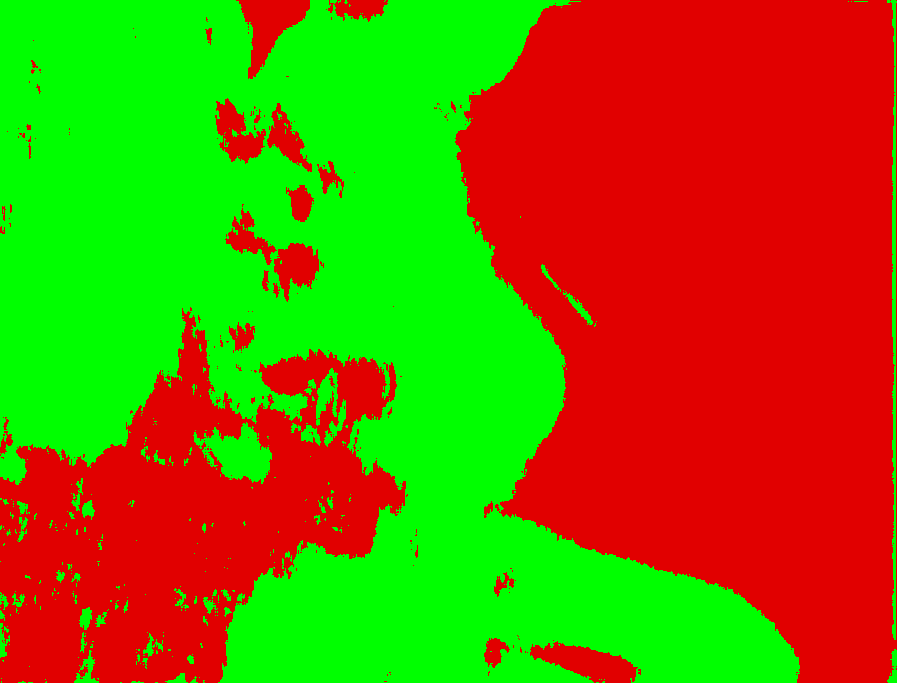

In [84]:
classified_image1

In [85]:
path = os.path.abspath('./data/images/santa_helena_basemap_original.png')
original_image1 = PIL.Image.open(path).convert('RGB')

In [ ]:
path = os.path.abspath('./data/images/')
name = 'santa_helena_basemap'
original_image1.save(path + name + f"_original.png")

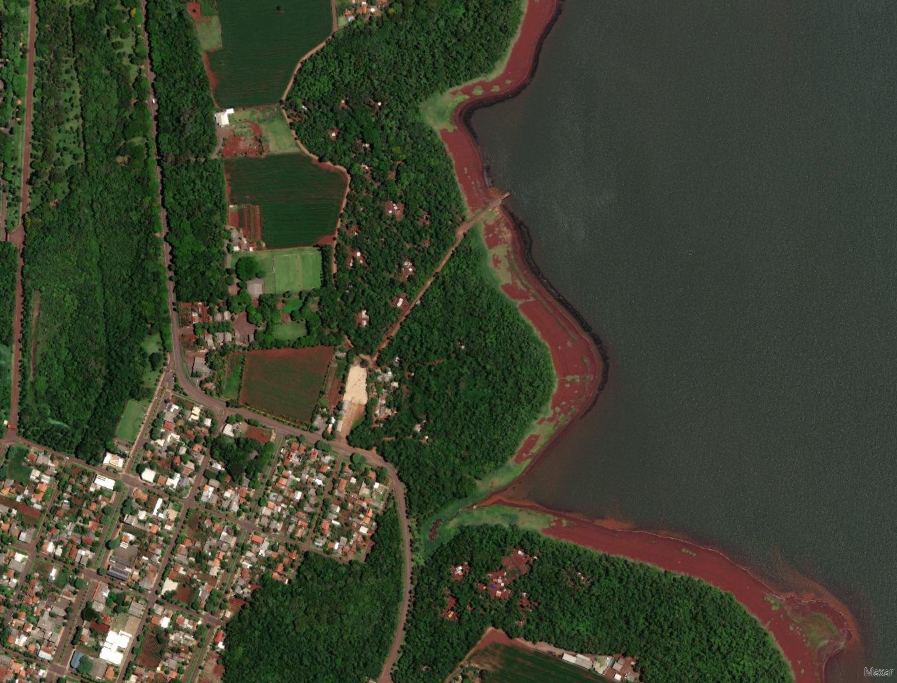

In [ ]:
original_image1

In [86]:
blended_image1 = PIL.Image.blend(original_image1, classified_image1, 0.25)

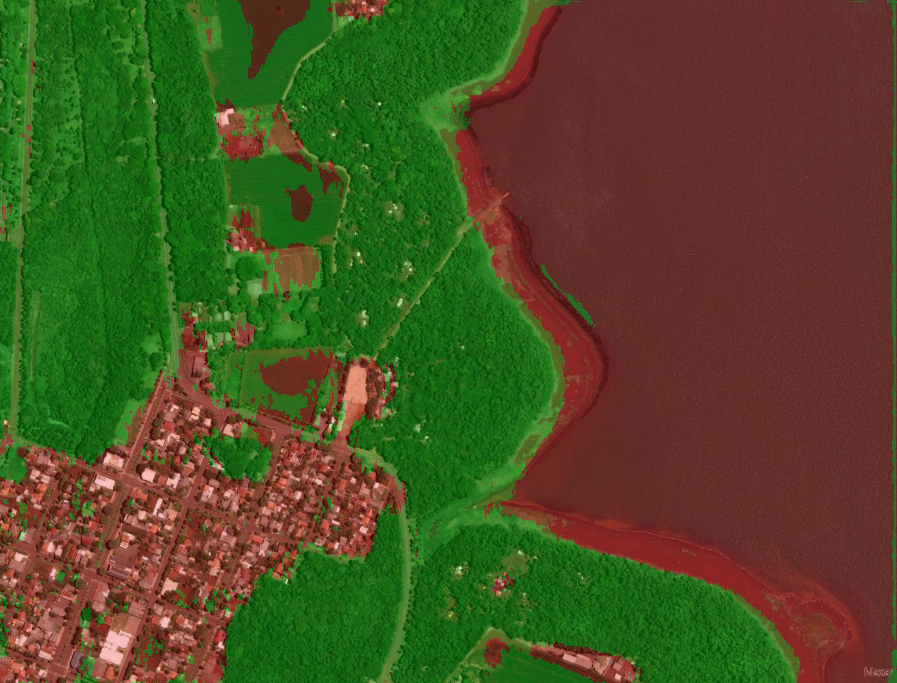

In [87]:
blended_image1

In [88]:
path = os.path.abspath('./data/dataset_tcc/results/')
name = 'classifier4_santa_helena_basemap'
blended_image1.save(path + name + f"_sobreposta.png")

#### Segunda imagem de exemplo de local aleatório

In [89]:
classes_colors = {0:(225, 0, 0), 1:(0, 255, 0)}

a = Analyser(reconstructed_model, classes_colors, 64)
path = os.path.abspath('./data/images/basemap5_original.png')

classified_image2 = a.analyse(path, 10000)

2024-05-10 12:08:17.699130
2024-05-10 12:08:17.729131 - Running batch 1/52
2024-05-10 12:08:17.729131 - Chopping...
2024-05-10 12:08:18.323338 - Chopping completed.
2024-05-10 12:08:18.323338 - Predicting classes...
313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
2024-05-10 12:08:20.886355 - Prediction completed.
2024-05-10 12:08:20.913357 - Prediction completed.
2024-05-10 12:08:20.913357 - Running batch 2/52
2024-05-10 12:08:20.913357 - Chopping...
2024-05-10 12:08:21.845585 - Chopping completed.
2024-05-10 12:08:21.846580 - Predicting classes...
313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
2024-05-10 12:08:24.279460 - Prediction completed.
2024-05-10 12:08:24.299461 - Prediction completed.
2024-05-10 12:08:24.299461 - Running batch 3/52
2024-05-10 12:08:24.299461 - Chopping...
2024-05-10 12:08:25.321675 - Chopping completed.
2024-05-10 12:08:25.321675 - Predicting classes...
313/313 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step
2024-05-10 12:08:28.145709 - Prediction completed.
2024-05-10 12:08:28.164712 -

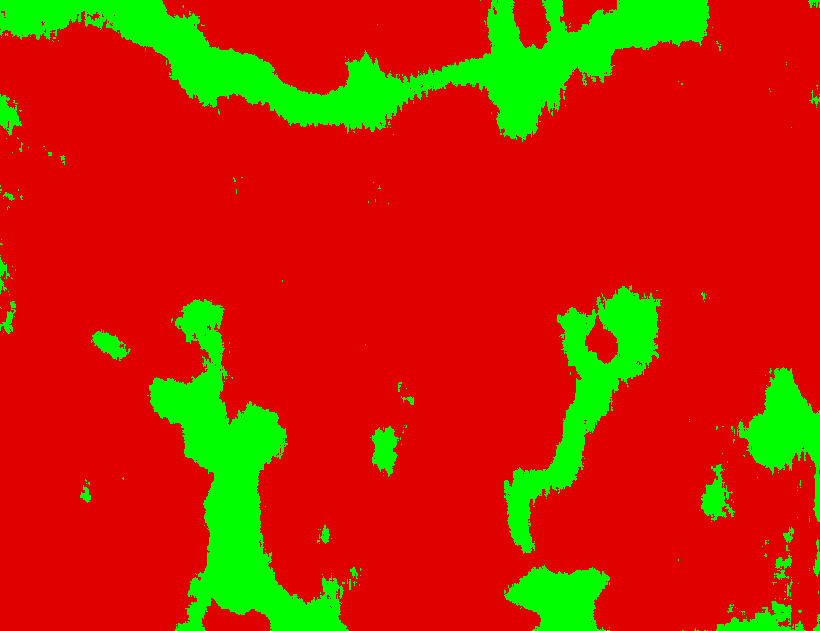

In [90]:
classified_image2

In [91]:
path = os.path.abspath('./data/dataset_tcc/results/')
name = 'classifier4_basemap5'
classified_image2.save(path + name + f"_segmentada.png")

In [92]:
path = os.path.abspath('./data/images/basemap5_original.png')
original_image2 = PIL.Image.open(path).convert('RGB')

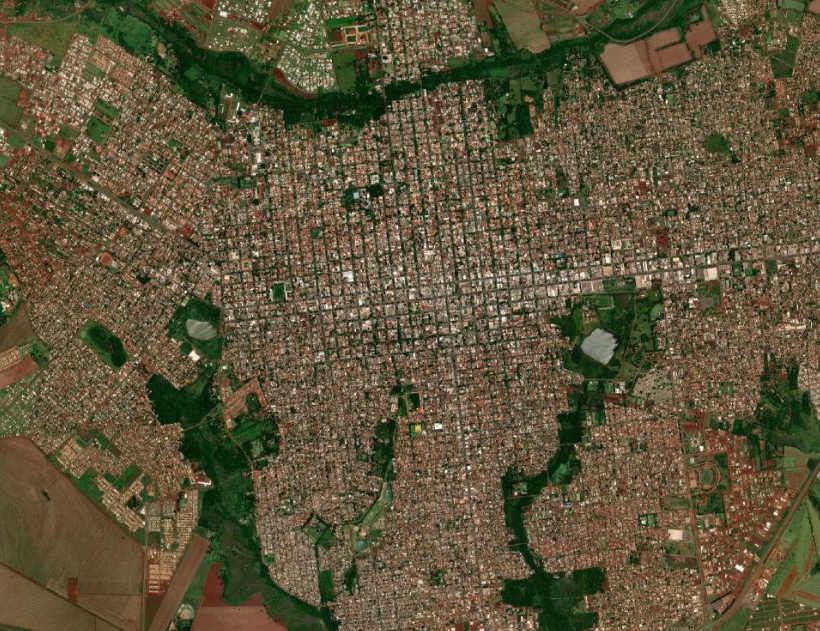

In [ ]:
original_image2

In [93]:
blended_image2 = PIL.Image.blend(original_image2, classified_image2, 0.25)

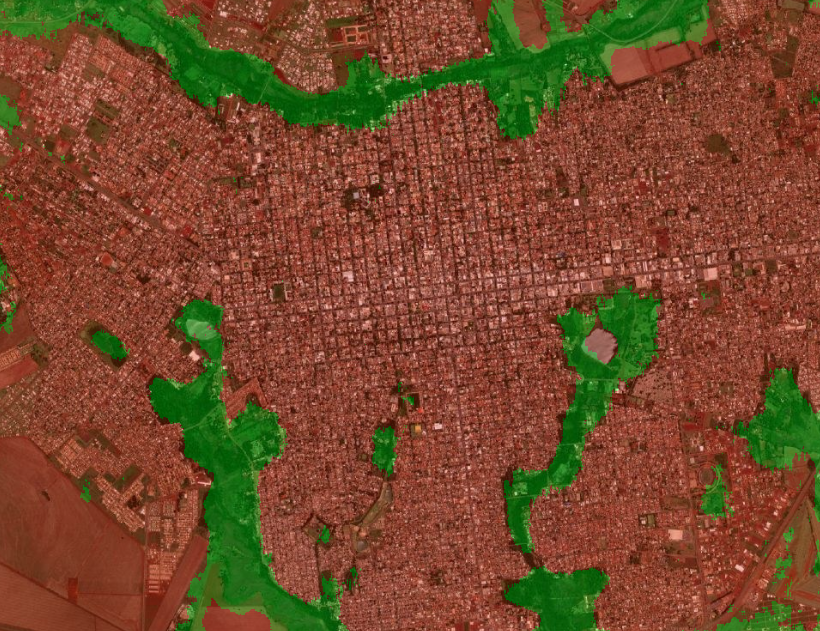

In [94]:
blended_image2

In [95]:
path = os.path.abspath('./data/dataset_tcc/results/')
name = 'classifier4_basemap5'
blended_image2.save(path + name + f"_blended.png")

# Quinto modelo de teste

Mudei a arquitetura para a LeNet

In [26]:
classifier = Sequential()

classifier.add(Conv2D(6, kernel_size=(5, 5), strides=(1, 1), activation='tanh', input_shape=(64,64,3), padding="same"))

# Pooling 
classifier.add(AveragePooling2D(pool_size=(2, 2), strides=(2, 2), padding='valid'))

classifier.add(Conv2D(16, kernel_size=(5, 5), strides=(1, 1), activation='tanh', padding='valid'))

# Pooling
classifier.add(AveragePooling2D(pool_size=(2, 2), strides=(2, 2), padding='valid'))

# Flattening
classifier.add(Flatten())

# Camada densa
classifier.add(Dense(units=120, activation='tanh'))

# camada densa
classifier.add(Dense(units=84, activation='tanh'))

# Camada de saída
classifier.add(Dense(units=2, activation='sigmoid'))

classifier.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

history5 = classifier.fit(prev_train, class_train, batch_size=32, epochs=10, validation_data=(prev_test, class_test))

c:\Workspaces\vivi-tcc\.venv\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:99: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(


Epoch 1/10
7392/7392 ━━━━━━━━━━━━━━━━━━━━ 158s 21ms/step - accuracy: 0.8246 - loss: 0.3881 - val_accuracy: 0.8839 - val_loss: 0.2813
Epoch 2/10
7392/7392 ━━━━━━━━━━━━━━━━━━━━ 103s 14ms/step - accuracy: 0.8987 - loss: 0.2492 - val_accuracy: 0.9033 - val_loss: 0.2399
Epoch 3/10
7392/7392 ━━━━━━━━━━━━━━━━━━━━ 106s 14ms/step - accuracy: 0.9149 - loss: 0.2139 - val_accuracy: 0.9122 - val_loss: 0.2230
Epoch 4/10
7392/7392 ━━━━━━━━━━━━━━━━━━━━ 123s 17ms/step - accuracy: 0.9211 - loss: 0.2000 - val_accuracy: 0.9028 - val_loss: 0.2396
Epoch 5/10
7392/7392 ━━━━━━━━━━━━━━━━━━━━ 116s 16ms/step - accuracy: 0.9264 - loss: 0.1883 - val_accuracy: 0.9226 - val_loss: 0.1967
Epoch 6/10
7392/7392 ━━━━━━━━━━━━━━━━━━━━ 112s 15ms/step - accuracy: 0.9300 - loss: 0.1798 - val_accuracy: 0.9316 - val_loss: 0.1786
Epoch 7/10
7392/7392 ━━━━━━━━━━━━━━━━━━━━ 108s 15ms/step - accuracy: 0.9317 - loss: 0.1767 - val_accuracy: 0.9270 - val_loss: 0.1870
Epoch 8/10
7392/7392 ━━━━━━━━━━━━━━━━━━━━ 108s 15ms/step - accuracy: 

In [27]:
classifier.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 64, 64, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ average_pooling2d               │ (None, 32, 32, 6)      │             0 │
│ (AveragePooling2D)              │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 28, 28, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ average_pooling2d_1             │ (None, 14, 14, 16)     │             0 │
│ (AveragePooling2D)              │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 3136)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 120)            │       376,440 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 84)             │        10,164 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 2)              │           170 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,168,940 (4.46 MB)

 Trainable params: 389,646 (1.49 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 779,294 (2.97 MB)

In [28]:
_, train_acc = classifier.evaluate(prev_train, class_train, verbose=0)
_, test_acc = classifier.evaluate(prev_test, class_test, verbose=0)
print('Train: %.4f, Test: %.4f' % (train_acc, test_acc))

Train: 0.9305, Test: 0.9278


In [29]:
history5.history['accuracy']

[0.8646216988563538,
 0.903583288192749,
 0.9160095453262329,
 0.9220768213272095,
 0.9272984862327576,
 0.9305033683776855,
 0.931966245174408,
 0.9329091310501099,
 0.9343043565750122,
 0.9359660148620605]

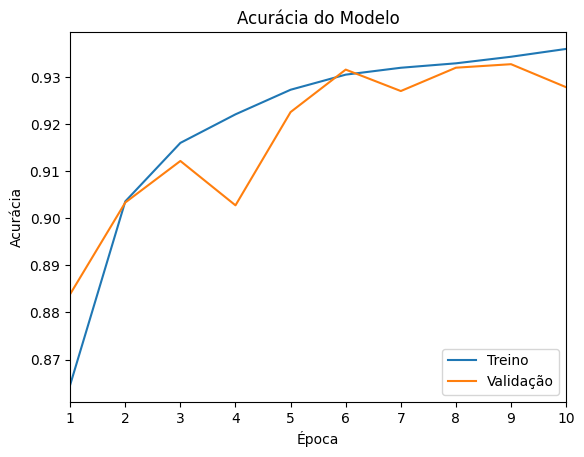

In [31]:
labels = ['1', '2', '3', '4', '5', '6', '7', '8', '9', '10']

plt.plot(history5.history['accuracy'], label='Treino')
plt.plot(history5.history['val_accuracy'], label='Validação')

plt.title('Acurácia do Modelo')
plt.xlabel('Época')
plt.ylabel('Acurácia')

plt.legend(loc='lower right')
# plt.ylim(0.8, 1)
plt.xlim(0, 9)

formatter = mticker.FuncFormatter(lambda x, pos: "{:.2f}".format(x))
plt.gca().yaxis.set_major_formatter(formatter)
plt.xticks(range(0, 10), labels)


plt.show()

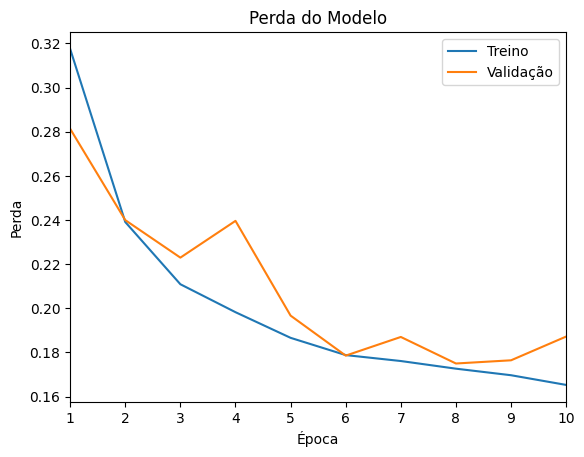

In [77]:
labels = ['1', '2', '3', '4', '5', '6', '7', '8', '9', '10']

plt.plot(history5.history['loss'], label='Treino')
plt.plot(history5.history['val_loss'], label='Validação')
plt.title('Perda do Modelo')
plt.xlabel('Época')
plt.ylabel('Perda')
plt.legend(loc='upper right')
plt.xlim(0, 9)

formatter = mticker.FuncFormatter(lambda x, pos: "{:.2f}".format(x))
plt.gca().yaxis.set_major_formatter(formatter)
plt.xticks(range(0, 10), labels)

plt.show()

In [32]:
path = os.path.abspath('./data/dataset_tcc/classifier5.keras')

classifier.save(path)

### Avaliação pelo coeficiente de Kappa e Matriz de confusão

In [78]:
print(class_test.shape)

(59129, 2)


Como o class_test é um vetor one-hot encoded, precisa converter para vetor de rotulos de classe para poder avaliar com kappa e matriz de confusao

In [ ]:
path = os.path.abspath('./data/dataset_tcc/classifier5.keras')
reconstructed_model = tf.keras.models.load_model(path)

In [82]:
# Converte class_test de one-hot encoded para rótulos de classe
class_test = np.argmax(class_test, axis=1)

# Faz previsões nos dados de teste
class_pred = reconstructed_model.predict(prev_test, batch_size=32)

# Converte as previsões para rótulos de classe
class_pred = np.argmax(class_pred, axis=1)

conf_mat = confusion_matrix(class_test, class_pred)

print("Matriz de Confusão:")
print(conf_mat)

kappa = cohen_kappa_score(class_test, class_pred)

print("\nCoeficiente de Kappa: ", kappa)

1848/1848 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step
Matriz de Confusão:
[[25438  3588]
 [ 1586 28517]]

Coeficiente de Kappa:  0.8247184654639526


### Segmentação das imagens

In [12]:
# Retorna as coordenadas de uma bounding box ao redor da posição com o tamanho especificado
def box(position, size):
    
    x, y = position
    left = x - size // 2
    upper = y - size // 2
    right = left + size
    lower = upper + size
    return (left, upper, right, lower)

# Para cada pixel da imagem, cria uma bounding box ao redor desse pixel e recorta a imagem
def subimages(image, box_size):
    
    width, height = image.size
    for x in range(width):
        for y in range(height):
            position = x, y
            bouding_box = box(position, box_size)
            yield image.crop(bouding_box)

# Para cada pixel da imagem, define a cor desse pixel para a próxima cor na sequência
def colorize(image, colors):
    
    width, height = image.size
    i = iter(colors)
    for x in range(width):
        for y in range(height):
            position = x, y
            try:
                color = next(i)
            except:
                return
            image.putpixel(position, color)

# Recebe uma lista de previsões e retorna uma lista de classes, mapeando a função prediction2class para cada previsão na lista

def prediction2class(prediction):
    return sorted(enumerate([i for i in prediction]), key=lambda x: x[1])[-1][0]

def predictions2classes(predictions):
    return list(map(prediction2class, predictions))


class Analyser:
    
    def __init__(self, neural_net, classes_colors, box_size):
        # Inicializa a classe com a rede neural, as cores das classes e o tamanho da bounding box 
        self.neural_net = neural_net
        self.classes_colors = classes_colors
        self.box_size = box_size
        self.image = None

    def analyse(self, image, batch_size = -1):
        # Imprime a data e hora atual
        print(f"{datetime.datetime.now()}")

        # Abre a imagem e converte para RGB
        if isinstance(image, str):
            image = Image.open(image).convert('RGB')
        self.image = image

        # Obtém a largura e a altura da imagem
        width, height = image.size
        counter = width*height

        # Cria uma nova imagem com o mesmo tamanho da imagem original
        self.classified_image = Image.new("RGB", image.size)

        # Se o tamanho do lote for menor que 0, define o tamanho do lote como o contador
        if batch_size < 0:
            batch_size = counter

        # Cria subimagens da imagem original
        iter_images = subimages(image, self.box_size)

        # Inicializa as listas e classes de previsões
        self.predictions = []
        self.predictions_classes = []

        # Inicializa o contador de lotes e o número máximo de lotes
        batch_counter = 1
        max_batches = math.ceil(counter / batch_size)

        try:
            
            while counter > 0:
                
                print(f"{datetime.datetime.now()} - Rodando o lote {batch_counter}/{max_batches}")
                batch_counter += 1
                
                print(f"{datetime.datetime.now()} - Cortando")
                images = [np.array(next(iter_images), dtype=np.float32)/255 for i in range(min(batch_size, counter))]
                X = np.array(images)

                print(f"{datetime.datetime.now()} - Corte Completo")

                print(f"{datetime.datetime.now()} - Prevendo as classes")
                predictions = self.neural_net.predict(X)

                print(f"{datetime.datetime.now()} - Previsao completa")

                # Adiciona as classes previstas à lista
                self.predictions_classes.extend(predictions2classes(predictions))
               
                print(f"{datetime.datetime.now()} - Completo")

                # Diminui o contador pelo tamanho do lote
                counter -= batch_size

        #Imprime a data e hora atual e a exceção
        except Exception as e:
            print(f"{datetime.datetime.now()} - Erro {e}")

        print(f"{datetime.datetime.now()} - Colorindo a imagem final")

        # Mapeia as cores das classes para as classes previstas e pinta a imagem
        colors = map(self.classes_colors.get, self.predictions_classes)
        colorize(self.classified_image, colors)

        print(f"{datetime.datetime.now()} - Acabou")

        return self.classified_image

#### Primeira imagem de exemplo (Santa Helena - 23/09/18)

In [35]:
classes_colors = {0:(225, 0, 0), 1:(0, 255, 0)}
a = Analyser(reconstructed_model, classes_colors, 64)

path = os.path.abspath('./data/images/santa_helena_basemap_original.png')
classified_image1 = a.analyse(path, 5000)

2024-05-12 19:36:03.211234
2024-05-12 19:36:03.252240 - Running batch 1/123
2024-05-12 19:36:03.252240 - Chopping...
2024-05-12 19:36:03.841232 - Chopping completed.
2024-05-12 19:36:03.841232 - Predicting classes...
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
2024-05-12 19:36:05.041251 - Prediction completed.
2024-05-12 19:36:05.052255 - Prediction completed.
2024-05-12 19:36:05.052255 - Running batch 2/123
2024-05-12 19:36:05.052255 - Chopping...
2024-05-12 19:36:05.807356 - Chopping completed.
2024-05-12 19:36:05.808357 - Predicting classes...
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
2024-05-12 19:36:06.648539 - Prediction completed.
2024-05-12 19:36:06.658540 - Prediction completed.
2024-05-12 19:36:06.658540 - Running batch 3/123
2024-05-12 19:36:06.658540 - Chopping...
2024-05-12 19:36:07.449742 - Chopping completed.
2024-05-12 19:36:07.450744 - Predicting classes...
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
2024-05-12 19:36:08.445111 - Prediction completed.
2024-05-12 19:36:08.45711

In [36]:
path = os.path.abspath('./data/dataset_tcc/results/')
name = 'classifier5_santa_helena_basemap'
classified_image1.save(path + '\\' + name + f"_segmentada.png")

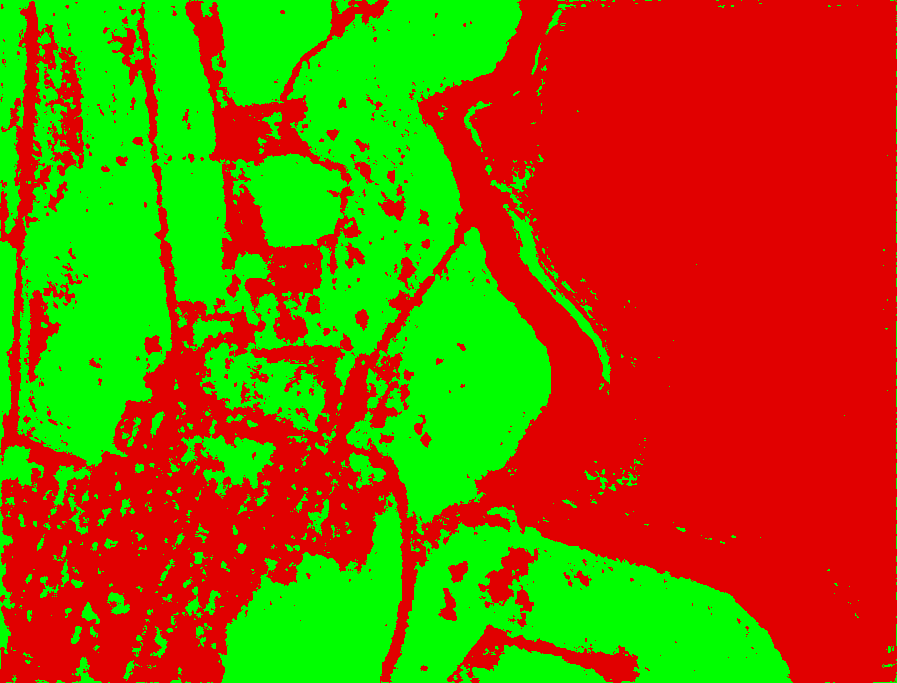

In [37]:
classified_image1

In [38]:
path = os.path.abspath('./data/images/santa_helena_basemap_original.png')
original_image1 = PIL.Image.open(path).convert('RGB')

In [39]:
path = os.path.abspath('./data/dataset_tcc/results/')
name = 'classifier5_santa_helena_basemap'
original_image1.save(path + '\\' + name + f"_original.png")

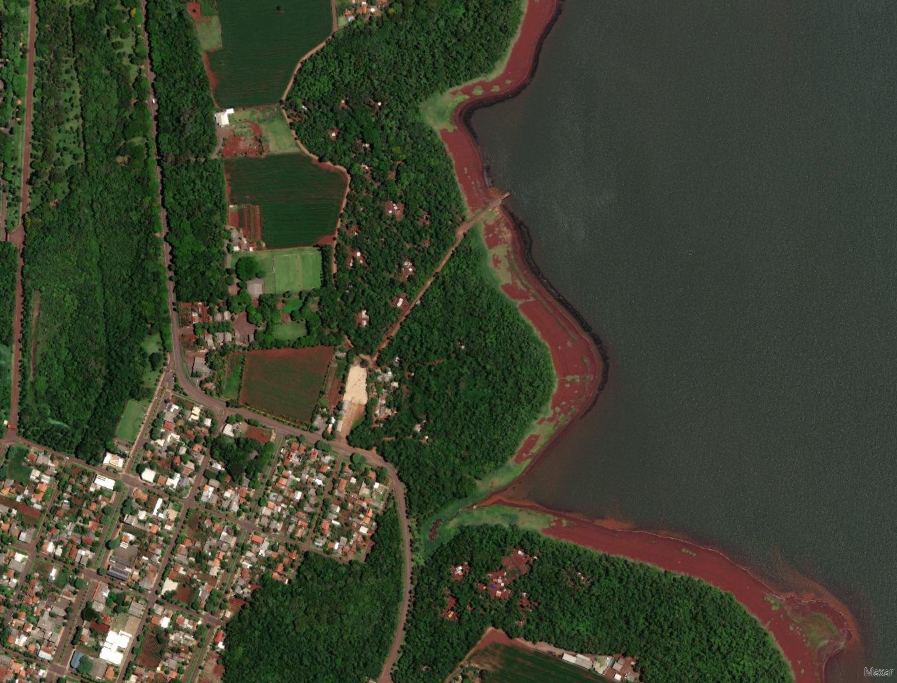

In [40]:
original_image1

In [41]:
blended_image1 = PIL.Image.blend(original_image1, classified_image1, 0.25)

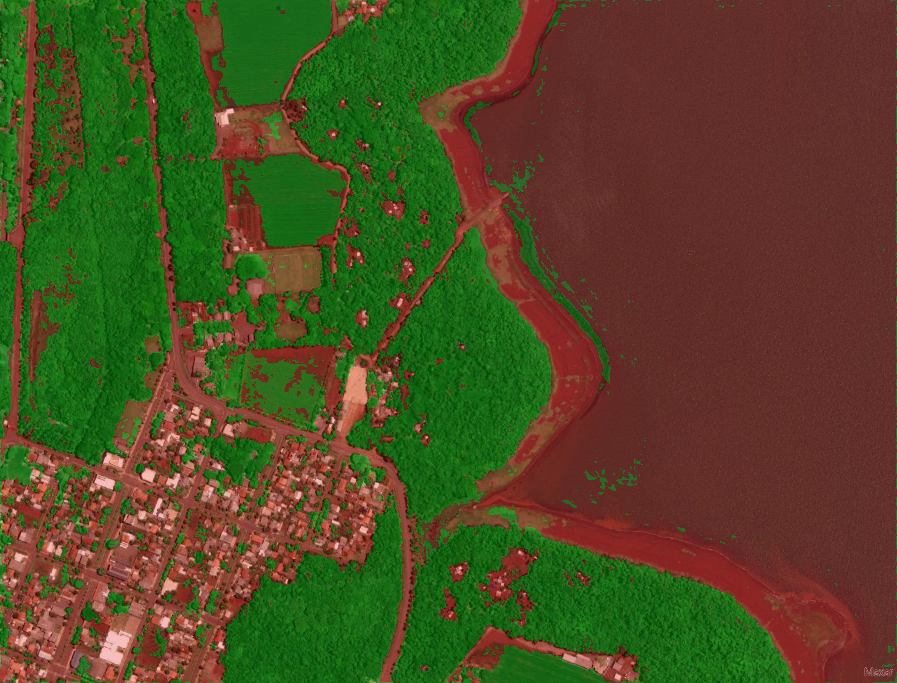

In [42]:
blended_image1

In [43]:
path = os.path.abspath('./data/dataset_tcc/results/')
name = 'classifier5_santa_helena_basemap'
blended_image1.save(path + '\\' + name + f"_sobreposta.png")

#### Segunda imagem de exemplo de local aleatório

In [44]:
classes_colors = {0:(225, 0, 0), 1:(0, 255, 0)}

a = Analyser(reconstructed_model, classes_colors, 64)
path = os.path.abspath('./data/images/basemap5_original.png')

classified_image2 = a.analyse(path, 10000)

2024-05-12 19:39:00.243884
2024-05-12 19:39:00.277878 - Running batch 1/52
2024-05-12 19:39:00.277878 - Chopping...
2024-05-12 19:39:01.205062 - Chopping completed.
2024-05-12 19:39:01.206062 - Predicting classes...
313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
2024-05-12 19:39:03.052206 - Prediction completed.
2024-05-12 19:39:03.076208 - Prediction completed.
2024-05-12 19:39:03.076208 - Running batch 2/52
2024-05-12 19:39:03.076208 - Chopping...
2024-05-12 19:39:04.121817 - Chopping completed.
2024-05-12 19:39:04.121817 - Predicting classes...
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
2024-05-12 19:39:05.818567 - Prediction completed.
2024-05-12 19:39:05.836568 - Prediction completed.
2024-05-12 19:39:05.836568 - Running batch 3/52
2024-05-12 19:39:05.836568 - Chopping...
2024-05-12 19:39:07.134728 - Chopping completed.
2024-05-12 19:39:07.135731 - Predicting classes...
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
2024-05-12 19:39:08.550290 - Prediction completed.
2024-05-12 19:39:08.568289 -

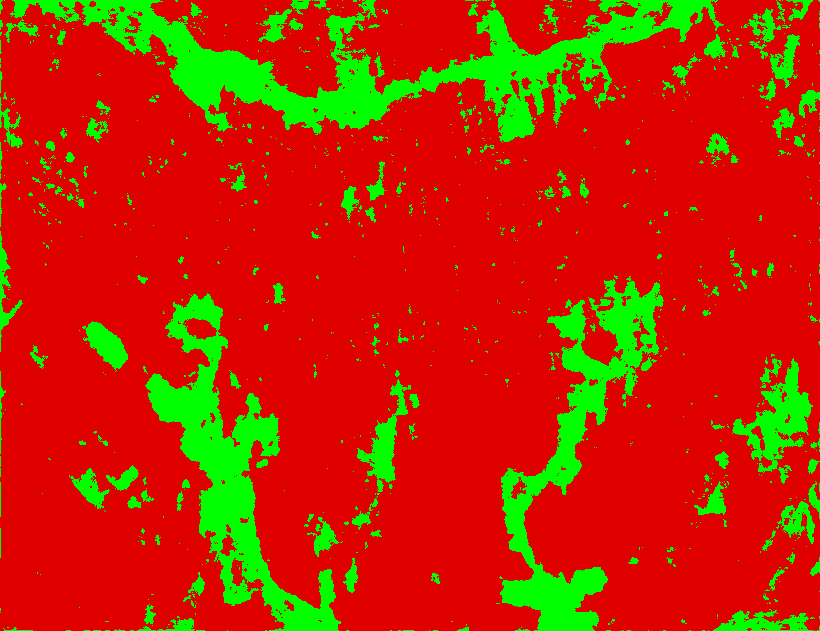

In [45]:
classified_image2

In [46]:
path = os.path.abspath('./data/dataset_tcc/results/')
name = 'classifier5_basemap5'
classified_image2.save(path + '\\' + name + f"_segmentada.png")

In [47]:
path = os.path.abspath('./data/images/basemap5_original.png')
original_image2 = PIL.Image.open(path).convert('RGB')

In [ ]:
path = os.path.abspath('./data/dataset_tcc/results/')
name = 'classifier5_basemap5'
original_image2.save(path + '\\' + name + f"_original1.png")

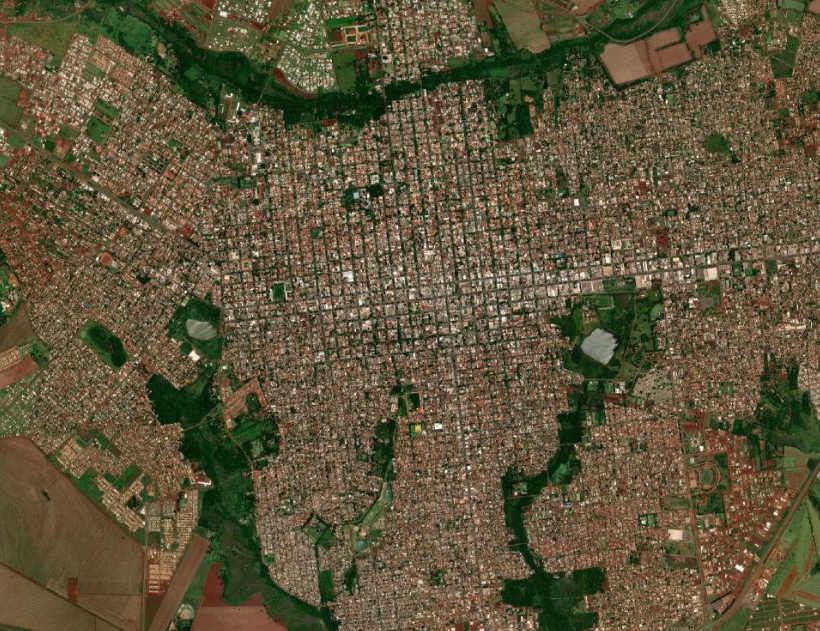

In [ ]:
original_image2

In [48]:
blended_image2 = PIL.Image.blend(original_image2, classified_image2, 0.25)

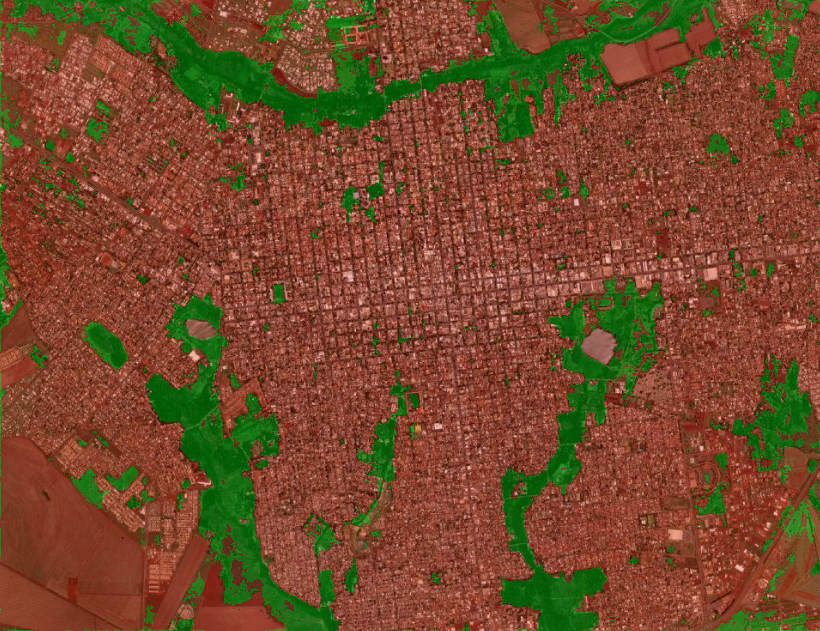

In [49]:
blended_image2

In [50]:
path = os.path.abspath('./data/dataset_tcc/results/')
name = 'classifier5_basemap5'
blended_image2.save(path + '\\' + name + f"_blended.png")

# Sexto teste

Usei a arquitetura LeNet no primeiro dataset

In [25]:

classifier = Sequential()

classifier.add(Conv2D(6, kernel_size=(5, 5), strides=(1, 1), activation='tanh', input_shape=(64,64,3), padding="same"))

classifier.add(AveragePooling2D(pool_size=(2, 2), strides=(2, 2), padding='valid'))

classifier.add(Conv2D(16, kernel_size=(5, 5), strides=(1, 1), activation='tanh', padding='valid'))

classifier.add(AveragePooling2D(pool_size=(2, 2), strides=(2, 2), padding='valid'))

classifier.add(Flatten())

classifier.add(Dense(units=120, activation='tanh'))

classifier.add(Dense(units=84, activation='tanh'))

# Camada de saída
classifier.add(Dense(units=2, activation='sigmoid'))

classifier.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

history6 = classifier.fit(prev_train, class_train, batch_size=32, epochs=10, validation_data=(prev_test, class_test))

c:\Workspaces\vivi-tcc\.venv\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:99: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(


Epoch 1/10
8152/8152 ━━━━━━━━━━━━━━━━━━━━ 141s 17ms/step - accuracy: 0.8723 - loss: 0.2813 - val_accuracy: 0.9416 - val_loss: 0.1429
Epoch 2/10
8152/8152 ━━━━━━━━━━━━━━━━━━━━ 189s 23ms/step - accuracy: 0.9394 - loss: 0.1533 - val_accuracy: 0.9330 - val_loss: 0.1661
Epoch 3/10
8152/8152 ━━━━━━━━━━━━━━━━━━━━ 115s 14ms/step - accuracy: 0.9422 - loss: 0.1447 - val_accuracy: 0.9390 - val_loss: 0.1523
Epoch 4/10
8152/8152 ━━━━━━━━━━━━━━━━━━━━ 104s 13ms/step - accuracy: 0.9452 - loss: 0.1367 - val_accuracy: 0.9539 - val_loss: 0.1180
Epoch 5/10
8152/8152 ━━━━━━━━━━━━━━━━━━━━ 101s 12ms/step - accuracy: 0.9476 - loss: 0.1302 - val_accuracy: 0.9447 - val_loss: 0.1344
Epoch 6/10
8152/8152 ━━━━━━━━━━━━━━━━━━━━ 92s 11ms/step - accuracy: 0.9508 - loss: 0.1255 - val_accuracy: 0.9486 - val_loss: 0.1324
Epoch 7/10
8152/8152 ━━━━━━━━━━━━━━━━━━━━ 95s 12ms/step - accuracy: 0.9511 - loss: 0.1229 - val_accuracy: 0.9545 - val_loss: 0.1104
Epoch 8/10
8152/8152 ━━━━━━━━━━━━━━━━━━━━ 97s 12ms/step - accuracy: 0.9

In [26]:
classifier.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 64, 64, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ average_pooling2d               │ (None, 32, 32, 6)      │             0 │
│ (AveragePooling2D)              │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 28, 28, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ average_pooling2d_1             │ (None, 14, 14, 16)     │             0 │
│ (AveragePooling2D)              │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 3136)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 120)            │       376,440 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 84)             │        10,164 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 2)              │           170 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,168,940 (4.46 MB)

 Trainable params: 389,646 (1.49 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 779,294 (2.97 MB)

In [27]:
_, train_acc = classifier.evaluate(prev_train, class_train, verbose=0)
_, test_acc = classifier.evaluate(prev_test, class_test, verbose=0)
print('Train: %.4f, Test: %.4f' % (train_acc, test_acc))

Train: 0.9594, Test: 0.9593


In [28]:
history6.history['accuracy']

[0.9158504009246826,
 0.9394698143005371,
 0.9416090250015259,
 0.9447219371795654,
 0.9479729533195496,
 0.9505645036697388,
 0.9520021677017212,
 0.9543445110321045,
 0.9566370844841003,
 0.9561693668365479]

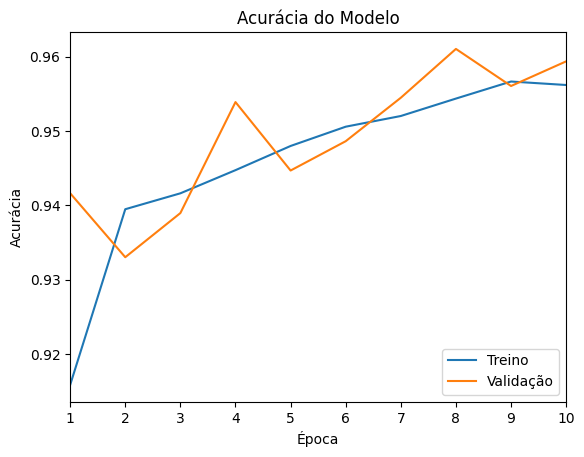

In [29]:
labels = ['1', '2', '3', '4', '5', '6', '7', '8', '9', '10']

plt.plot(history.history['accuracy'], label='Treino')
plt.plot(history.history['val_accuracy'], label='Validação')

plt.title('Acurácia do Modelo')
plt.xlabel('Época')
plt.ylabel('Acurácia')

plt.legend(loc='lower right')
# plt.ylim(0.8, 1)
plt.xlim(0, 9)

formatter = mticker.FuncFormatter(lambda x, pos: "{:.2f}".format(x))
plt.gca().yaxis.set_major_formatter(formatter)
plt.xticks(range(0, 10), labels)


plt.show()

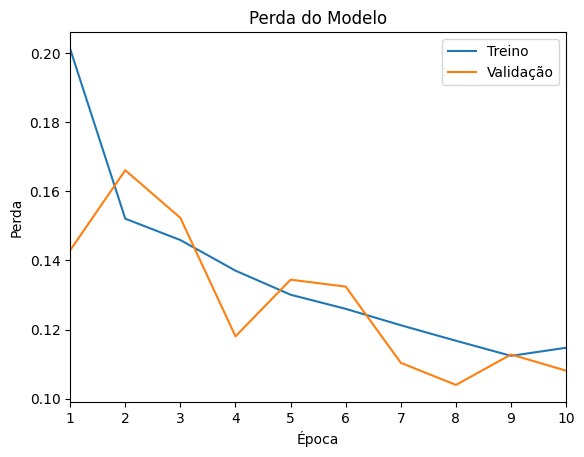

In [30]:
labels = ['1', '2', '3', '4', '5', '6', '7', '8', '9', '10']

plt.plot(history6.history['loss'], label='Treino')
plt.plot(history6.history['val_loss'], label='Validação')
plt.title('Perda do Modelo')
plt.xlabel('Época')
plt.ylabel('Perda')
plt.legend(loc='upper right')
plt.xlim(0, 9)

formatter = mticker.FuncFormatter(lambda x, pos: "{:.2f}".format(x))
plt.gca().yaxis.set_major_formatter(formatter)
plt.xticks(range(0, 10), labels)

plt.show()

In [31]:
path = os.path.abspath('./data/dataset_tcc/classifier6.keras')

classifier.save(path)

### Avaliação pelo coeficiente de Kappa e Matriz de confusão

In [ ]:
print(class_test.shape)

(59129, 2)


como o class_test é um vetor one-hot encoded, precisa converter para vetor de rotulos de classe para poder avaliar com kappa e matriz de confusao

In [32]:
path = os.path.abspath('./data/dataset_tcc/classifier6.keras')
reconstructed_model = tf.keras.models.load_model(path)

In [33]:
# Converte class_test de one-hot encoded para rótulos de classe
class_test = np.argmax(class_test, axis=1)

# Faz previsões nos dados de teste
class_pred = reconstructed_model.predict(prev_test, batch_size=32)

# Converte as previsões para rótulos de classe
class_pred = np.argmax(class_pred, axis=1)

conf_mat = confusion_matrix(class_test, class_pred)

print("Matriz de Confusão:")
print(conf_mat)

kappa = cohen_kappa_score(class_test, class_pred)

print("\nCoeficiente de Kappa: ", kappa)

2038/2038 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step
Matriz de Confusão:
[[31511  1640]
 [ 1011 31050]]

Coeficiente de Kappa:  0.9186994463874605


### Segmentação das imagens

In [ ]:
reconstructed_model = tf.keras.models.load_model(path)

In [34]:
# Retorna as coordenadas de uma bounding box ao redor da posição com o tamanho especificado
def box(position, size):
    
    x, y = position
    left = x - size // 2
    upper = y - size // 2
    right = left + size
    lower = upper + size
    return (left, upper, right, lower)

# Para cada pixel da imagem, cria uma bounding box ao redor desse pixel e recorta a imagem
def subimages(image, box_size):
    
    width, height = image.size
    for x in range(width):
        for y in range(height):
            position = x, y
            bouding_box = box(position, box_size)
            yield image.crop(bouding_box)

# Para cada pixel da imagem, define a cor desse pixel para a próxima cor na sequência
def colorize(image, colors):
    
    width, height = image.size
    i = iter(colors)
    for x in range(width):
        for y in range(height):
            position = x, y
            try:
                color = next(i)
            except:
                return
            image.putpixel(position, color)

# Recebe uma lista de previsões e retorna uma lista de classes, mapeando a função prediction2class para cada previsão na lista

def prediction2class(prediction):
    return sorted(enumerate([i for i in prediction]), key=lambda x: x[1])[-1][0]

def predictions2classes(predictions):
    return list(map(prediction2class, predictions))


class Analyser:
    
    def __init__(self, neural_net, classes_colors, box_size):
        # Inicializa a classe com a rede neural, as cores das classes e o tamanho da bounding box 
        self.neural_net = neural_net
        self.classes_colors = classes_colors
        self.box_size = box_size
        self.image = None

    def analyse(self, image, batch_size = -1):
        # Imprime a data e hora atual
        print(f"{datetime.datetime.now()}")

        # Abre a imagem e converte para RGB
        if isinstance(image, str):
            image = Image.open(image).convert('RGB')
        self.image = image

        # Obtém a largura e a altura da imagem
        width, height = image.size
        counter = width*height

        # Cria uma nova imagem com o mesmo tamanho da imagem original
        self.classified_image = Image.new("RGB", image.size)

        # Se o tamanho do lote for menor que 0, define o tamanho do lote como o contador
        if batch_size < 0:
            batch_size = counter

        # Cria subimagens da imagem original
        iter_images = subimages(image, self.box_size)

        # Inicializa as listas e classes de previsões
        self.predictions = []
        self.predictions_classes = []

        # Inicializa o contador de lotes e o número máximo de lotes
        batch_counter = 1
        max_batches = math.ceil(counter / batch_size)

        try:
            
            while counter > 0:
                
                print(f"{datetime.datetime.now()} - Rodando o lote {batch_counter}/{max_batches}")
                batch_counter += 1
                
                print(f"{datetime.datetime.now()} - Cortando")
                images = [np.array(next(iter_images), dtype=np.float32)/255 for i in range(min(batch_size, counter))]
                X = np.array(images)

                print(f"{datetime.datetime.now()} - Corte Completo")

                print(f"{datetime.datetime.now()} - Prevendo as classes")
                predictions = self.neural_net.predict(X)

                print(f"{datetime.datetime.now()} - Previsao completa")

                # Adiciona as classes previstas à lista
                self.predictions_classes.extend(predictions2classes(predictions))
               
                print(f"{datetime.datetime.now()} - Completo")

                # Diminui o contador pelo tamanho do lote
                counter -= batch_size

        #Imprime a data e hora atual e a exceção
        except Exception as e:
            print(f"{datetime.datetime.now()} - Erro {e}")

        print(f"{datetime.datetime.now()} - Colorindo a imagem final")

        # Mapeia as cores das classes para as classes previstas e pinta a imagem
        colors = map(self.classes_colors.get, self.predictions_classes)
        colorize(self.classified_image, colors)

        print(f"{datetime.datetime.now()} - Acabou")

        return self.classified_image

#### Primeira imagem de exemplo (Santa Helena - 23/09/18)

In [35]:
classes_colors = {0:(225, 0, 0), 1:(0, 255, 0)}
a = Analyser(reconstructed_model, classes_colors, 64)

path = os.path.abspath('./data/images/santa_helena_basemap_original.png')
classified_image1 = a.analyse(path, 5000)

2024-05-13 18:55:41.250493
2024-05-13 18:55:41.308491 - Running batch 1/123
2024-05-13 18:55:41.308491 - Chopping...
2024-05-13 18:55:41.915394 - Chopping completed.
2024-05-13 18:55:41.915394 - Predicting classes...
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
2024-05-13 18:55:43.276958 - Prediction completed.
2024-05-13 18:55:43.286956 - Prediction completed.
2024-05-13 18:55:43.286956 - Running batch 2/123
2024-05-13 18:55:43.286956 - Chopping...
2024-05-13 18:55:44.042037 - Chopping completed.
2024-05-13 18:55:44.042037 - Predicting classes...
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
2024-05-13 18:55:44.955212 - Prediction completed.
2024-05-13 18:55:44.966209 - Prediction completed.
2024-05-13 18:55:44.966209 - Running batch 3/123
2024-05-13 18:55:44.966209 - Chopping...
2024-05-13 18:55:45.774211 - Chopping completed.
2024-05-13 18:55:45.775211 - Predicting classes...
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
2024-05-13 18:55:46.754210 - Prediction completed.
2024-05-13 18:55:46.76821

In [36]:
path = os.path.abspath('./data/dataset_tcc/results/')
name = 'classifier6_santa_helena_basemap'
classified_image1.save(path + '\\' + name + f"_segmentada.png")

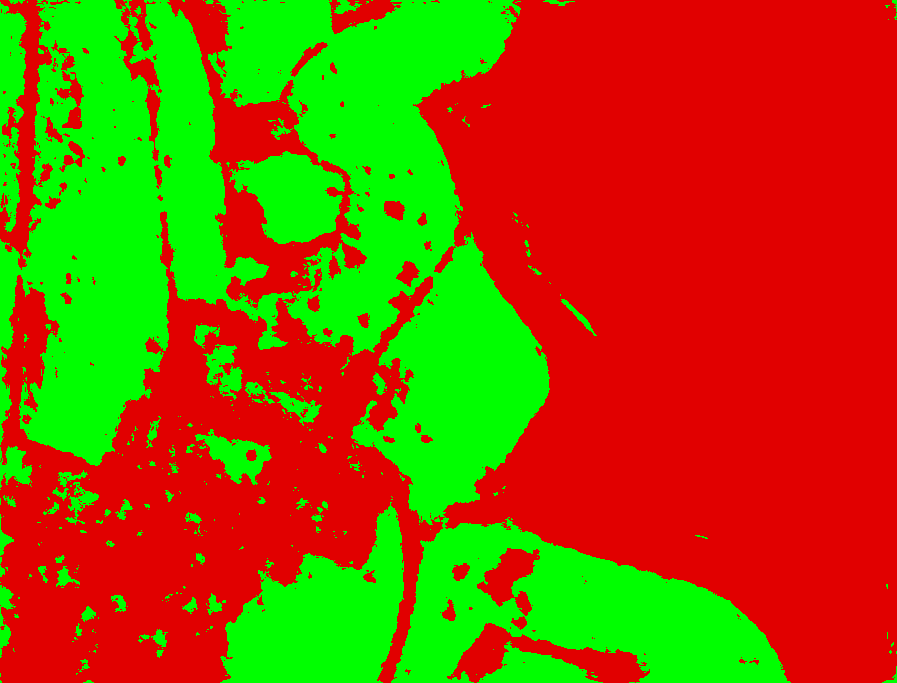

In [37]:
classified_image1

In [38]:
path = os.path.abspath('./data/images/santa_helena_basemap_original.png')
original_image1 = PIL.Image.open(path).convert('RGB')

In [ ]:
path = os.path.abspath('./data/dataset_tcc/results/')
name = 'classifier6_santa_helena_basemap'
original_image1.save(path + '\\' + name + f"_original.png")

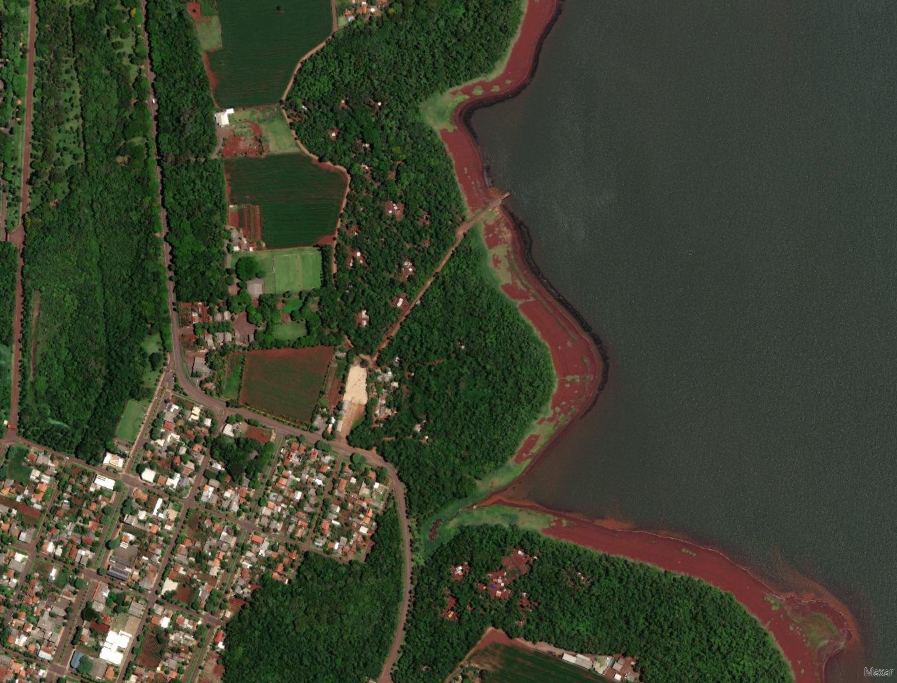

In [ ]:
original_image1

In [39]:
blended_image1 = PIL.Image.blend(original_image1, classified_image1, 0.25)

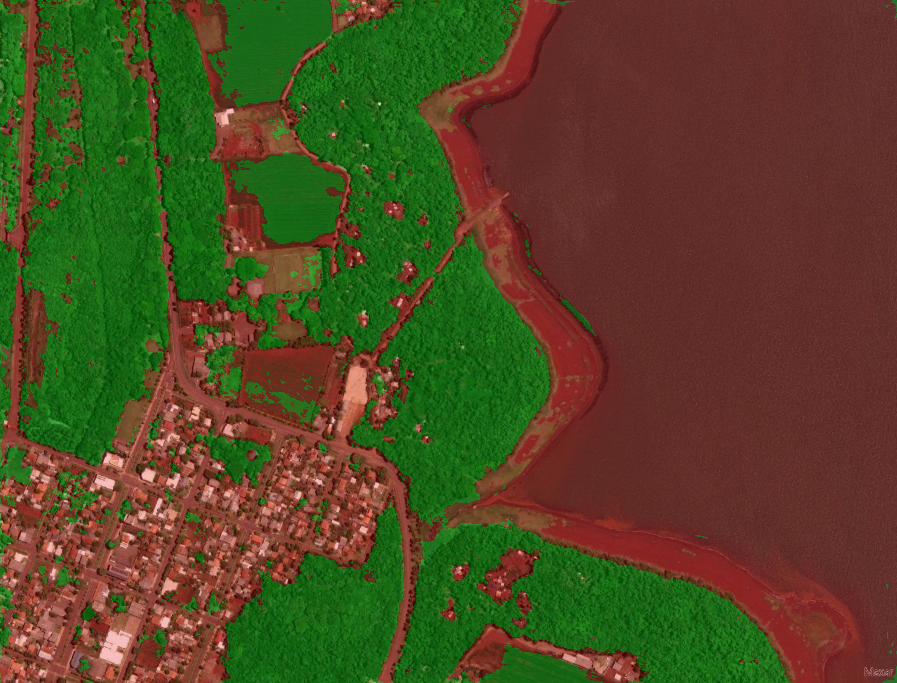

In [40]:
blended_image1

In [41]:
path = os.path.abspath('./data/dataset_tcc/results/')
name = 'classifier6_santa_helena_basemap'
blended_image1.save(path + '\\' + name + f"_sobreposta.png")

#### Segunda imagem de exemplo de local aleatório

In [42]:
classes_colors = {0:(225, 0, 0), 1:(0, 255, 0)}

a = Analyser(reconstructed_model, classes_colors, 64)
path = os.path.abspath('./data/images/basemap5_original.png')

classified_image2 = a.analyse(path, 10000)

2024-05-13 18:58:43.294900
2024-05-13 18:58:43.326897 - Running batch 1/52
2024-05-13 18:58:43.326897 - Chopping...
2024-05-13 18:58:44.327900 - Chopping completed.
2024-05-13 18:58:44.327900 - Predicting classes...
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
2024-05-13 18:58:45.846480 - Prediction completed.
2024-05-13 18:58:45.873477 - Prediction completed.
2024-05-13 18:58:45.873477 - Running batch 2/52
2024-05-13 18:58:45.873477 - Chopping...
2024-05-13 18:58:47.283275 - Chopping completed.
2024-05-13 18:58:47.284277 - Predicting classes...
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
2024-05-13 18:58:48.724658 - Prediction completed.
2024-05-13 18:58:48.743657 - Prediction completed.
2024-05-13 18:58:48.743657 - Running batch 3/52
2024-05-13 18:58:48.743657 - Chopping...
2024-05-13 18:58:50.200832 - Chopping completed.
2024-05-13 18:58:50.200832 - Predicting classes...
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
2024-05-13 18:58:51.652020 - Prediction completed.
2024-05-13 18:58:51.672019 -

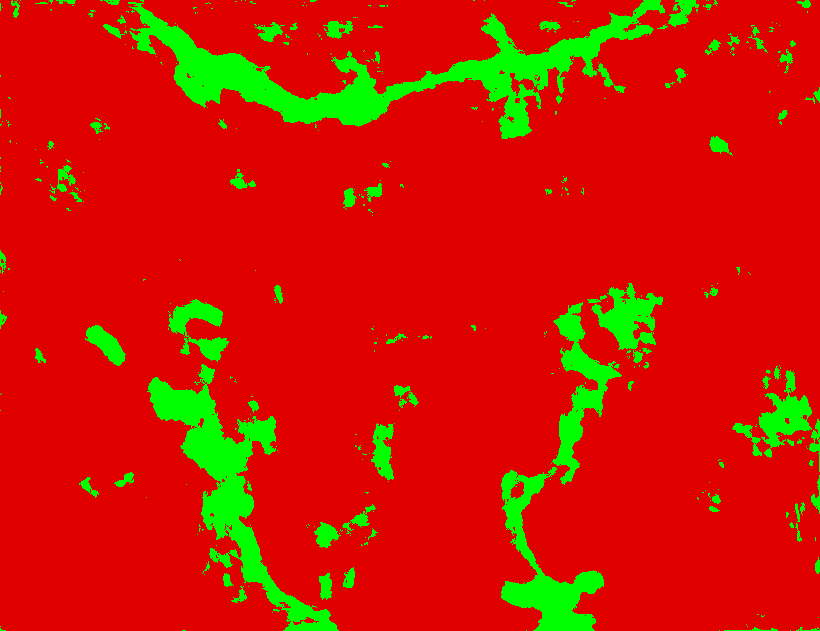

In [43]:
classified_image2

In [44]:
path = os.path.abspath('./data/dataset_tcc/results/')
name = 'classifier6_basemap5'
classified_image2.save(path + '\\' + name + f"_segmentada.png")

In [45]:
path = os.path.abspath('./data/images/basemap5_original.png')
original_image2 = PIL.Image.open(path).convert('RGB')

In [ ]:
path = os.path.abspath('./data/dataset_tcc/results/')
name = 'classifier6_basemap5'
original_image2.save(path + '\\' + name + f"_original1.png")

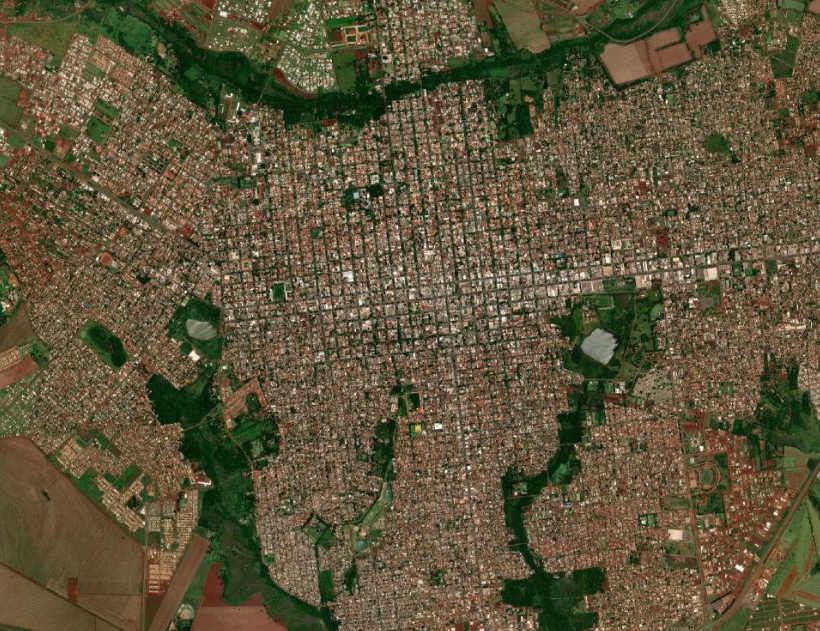

In [ ]:
original_image2

In [46]:
blended_image2 = PIL.Image.blend(original_image2, classified_image2, 0.25)

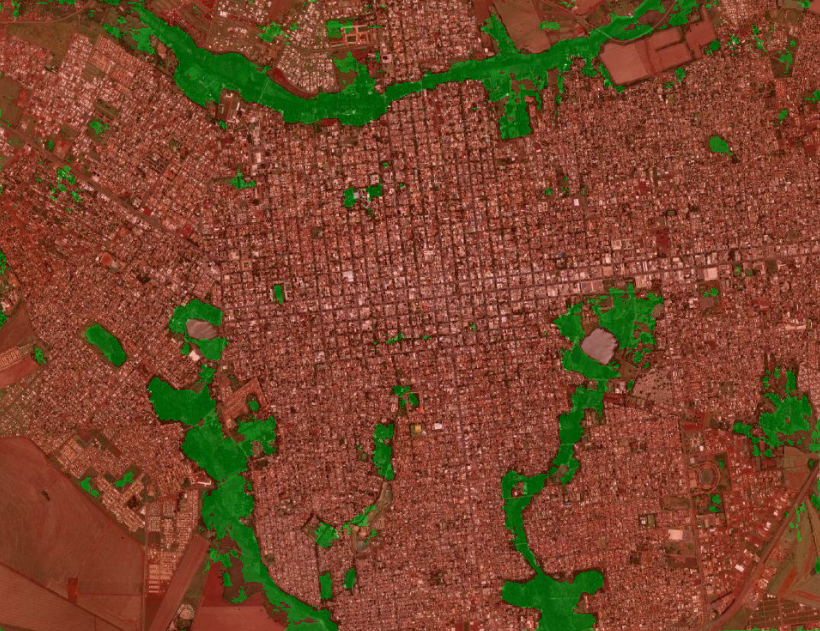

In [47]:
blended_image2

In [48]:
path = os.path.abspath('./data/dataset_tcc/results/')
name = 'classifier6_basemap5'
blended_image2.save(path + '\\' + name + f"_blended.png")

ACABA AQUI